Este código se corrió usando una vm.
Requiere cargar del modelo CelebA los siguientes archivos con las cantidades mencionadas de imágenes pre-procesadas:

* '/content/denoising_model/datasets/noisy_1000_train.npy'
* '/content/denoising_model/datasets/original_1000_train.npy'
* '/content/denoising_model/datasets/noisy_300_test.npy'
* '/content/denoising_model/datasets/original_300_test.npy'

Y el dataset con las imagenes del dataset propio en la carpeta:

* '/content/denoising_model/images/'



In [ ]:
from PIL import Image
import scipy.misc as misc
import os

import numpy as np
import matplotlib.pyplot as plt
import torch
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, ReLU
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import load_model

import datetime


In [ ]:
if torch.cuda.is_available():
    print("GPUs disponibles:")
    for i in range(torch.cuda.device_count()):
        print(torch.cuda.get_device_name(i))
else:
    print("No hay GPUs disponibles.")

GPUs disponibles:
NVIDIA L4


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


## Funciones para DnCNN

In [ ]:
# config

IMG_H = 256
IMG_W = 256
IMG_C = 1
DEPTH = 10
BATCH_SIZE = 2
EPOCHS = 50
SIGMA = 25
EPSILON = 1e-10

In [ ]:
# ops
def batchnorm(x, train_phase, scope_bn):
    with tf.variable_scope(scope_bn, reuse=tf.AUTO_REUSE):
        beta = tf.get_variable(name='beta', shape=[x.shape[-1]], initializer=tf.constant_initializer([0.]), trainable=True)
        gamma = tf.get_variable(name='gamma', shape=[x.shape[-1]], initializer=tf.constant_initializer([1.]), trainable=True)
        batch_mean, batch_var = tf.nn.moments(x, [0, 1, 2], name='moments')
        ema = tf.train.ExponentialMovingAverage(decay=0.5)

        def mean_var_with_update():
            ema_apply_op = ema.apply([batch_mean, batch_var])
            with tf.control_dependencies([ema_apply_op]):
                return tf.identity(batch_mean), tf.identity(batch_var)

        mean, var = tf.cond(train_phase, mean_var_with_update,
                            lambda: (ema.average(batch_mean), ema.average(batch_var)))
        normed = tf.nn.batch_normalization(x, mean, var, beta, gamma, 1e-3)
    return normed

def InstanceNorm(inputs, name):
    with tf.variable_scope(name):
        mean, var = tf.nn.moments(inputs, axes=[1, 2], keep_dims=True)
        scale = tf.get_variable("scale", shape=mean.shape[-1], initializer=tf.constant_initializer([1.]))
        shift = tf.get_variable("shift", shape=mean.shape[-1], initializer=tf.constant_initializer([0.]))
        return (inputs - mean) * scale / tf.sqrt(var + EPSILON) + shift

def conv(name, inputs, nums_out, ksize, strides, padding="SAME", is_SN=False):
    with tf.variable_scope(name):
        W = tf.get_variable("W", shape=[ksize, ksize, int(inputs.shape[-1]), nums_out], initializer=tf.truncated_normal_initializer(stddev=0.02))
        b = tf.get_variable("b", shape=[nums_out], initializer=tf.constant_initializer(0.))
        if is_SN:
            return tf.nn.conv2d(inputs, spectral_norm(name, W), [1, strides, strides, 1], padding) + b
        else:
            return tf.nn.conv2d(inputs, W, [1, strides, strides, 1], padding) + b

def uconv(name, inputs, nums_out, ksize, strides, padding="SAME"):
    with tf.variable_scope(name):
        w = tf.get_variable("W", shape=[ksize, ksize, nums_out, int(inputs.shape[-1])], initializer=tf.truncated_normal_initializer(stddev=0.02))
        b = tf.get_variable("b", [nums_out], initializer=tf.constant_initializer(0.))
    return tf.nn.conv2d_transpose(inputs, w, [tf.shape(inputs)[0], int(inputs.shape[1])*strides, int(inputs.shape[2])*strides, nums_out], [1, strides, strides, 1], padding=padding) + b


def fully_connected(name, inputs, nums_out):
    with tf.variable_scope(name, reuse=tf.AUTO_REUSE):
        W = tf.get_variable("W", [int(inputs.shape[-1]), nums_out], initializer=tf.truncated_normal_initializer(stddev=0.02))
        b = tf.get_variable("b", [nums_out], initializer=tf.constant_initializer(0.))
        return tf.matmul(inputs, W) + b


def spectral_norm(name, w, iteration=1):
    w_shape = w.shape.as_list()
    w = tf.reshape(w, [-1, w_shape[-1]])
    with tf.variable_scope(name, reuse=False):
        u = tf.get_variable("u", [1, w_shape[-1]], initializer=tf.truncated_normal_initializer(), trainable=False)
    u_hat = u
    v_hat = None

    def l2_norm(v, eps=1e-12):
        return v / (tf.reduce_sum(v ** 2) ** 0.5 + eps)

    for i in range(iteration):
        v_ = tf.matmul(u_hat, tf.transpose(w))
        v_hat = l2_norm(v_)
        u_ = tf.matmul(v_hat, w)
        u_hat = l2_norm(u_)
    sigma = tf.matmul(tf.matmul(v_hat, w), tf.transpose(u_hat))
    w_norm = w / sigma
    with tf.control_dependencies([u.assign(u_hat)]):
        w_norm = tf.reshape(w_norm, w_shape)
    return w_norm

def leaky_relu(x, slope=0.2):
    return tf.maximum(x, slope*x)



In [ ]:
# network
class net:
    def __init__(self, name):
        self.name = name

    def __call__(self, inputs, train_phase):
        with tf.variable_scope(self.name):
            # Primera capa convolucional con activación ReLU
            inputs = tf.nn.relu(conv("conv0", inputs, 64, 3, 1))

            # Capas intermedias según la profundidad definida
            for d in np.arange(1, DEPTH - 1):
                inputs = tf.nn.relu(batchnorm(conv("conv_" + str(d + 1), inputs, 64, 3, 1), train_phase, "bn" + str(d)))

            # Capa final que ajusta el número de canales a los de la imagen de entrada
            inputs = conv("conv" + str(DEPTH - 1), inputs, IMG_C, 3, 1)
            return inputs

In [ ]:
class DnCNN:
    def __init__(self, depth, filters=64, image_channels=1):
        self.model = self.build_model(depth, filters, image_channels)

    def build_model(self, depth, filters, image_channels):
        inputs = Input(shape=(None, None, image_channels))
        x = Conv2D(filters, (3, 3), padding='same', activation='relu')(inputs)

        for _ in range(1, depth - 1):
            x = Conv2D(filters, (3, 3), padding='same', use_bias=False)(x)
            x = BatchNormalization()(x)
            x = ReLU()(x)

        outputs = Conv2D(image_channels, (3, 3), padding='same')(x)
        model = Model(inputs=inputs, outputs=outputs)
        return model

    def train(self, x_train, y_train, batch_size, epochs):
        # Configuración para TensorBoard con directorio personalizado
        log_dir = "runs/denoising_model/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
        tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

        self.model.compile(optimizer='adam', loss='mean_squared_error')
        self.model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, callbacks=[tensorboard_callback])

    def predict(self, x_test):
        return self.model.predict(x_test)

    # tensorboard --logdir=denoising_model/runs

In [ ]:
depth = 12  # Profundidad de la red
batch_size = 4
epochs = 50
filters = 16
image_channels = 1

dncnn = DnCNN(depth=depth, filters=filters, image_channels=image_channels)

## Cargo las imágenes con y sin ruido Gaussiano

In [ ]:
noisy_images_train = np.load('/content/denoising_model/datasets/noisy_1000_train.npy', allow_pickle=True)
original_images_train = np.load('/content/denoising_model/datasets/original_1000_train.npy', allow_pickle=True)

noisy_images_test = np.load('/content/denoising_model/datasets/noisy_300_test.npy', allow_pickle=True)
original_images_test = np.load('/content/denoising_model/datasets/original_300_test.npy', allow_pickle=True)

print("noisy_images_train.shape:", noisy_images_train.shape)
print("original_images_train.shape:", original_images_train.shape)

print("noisy_images_test.shape:", noisy_images_test.shape)
print("original_images_test.shape:", original_images_test.shape)

noisy_images_train.shape: (1000, 256, 256)
original_images_train.shape: (1000, 256, 256)
noisy_images_test.shape: (300, 256, 256)
original_images_test.shape: (300, 256, 256)


## Entreno la DnCNN

In [ ]:
depth = 12
filters = 32
image_channels = 1  # Canales de imagen, 1 para escala de grises
batch_size = 4
epochs = 100

dncnn = DnCNN(depth=depth, filters=filters, image_channels=image_channels)
dncnn.model.compile(optimizer='adam', loss='mean_squared_error')
dncnn.model.fit(noisy_images_train, original_images_train, validation_data=(noisy_images_test, original_images_test), batch_size=batch_size, epochs=epochs)

Epoch 1/100
250/250 [==============================] - 15s 41ms/step - loss: 8615.6338 - val_loss: 1444.0033
Epoch 2/100
250/250 [==============================] - 10s 41ms/step - loss: 1063.1318 - val_loss: 813.3489
Epoch 3/100
250/250 [==============================] - 10s 41ms/step - loss: 368.4786 - val_loss: 2081.9268
Epoch 4/100
250/250 [==============================] - 10s 41ms/step - loss: 362.1261 - val_loss: 379.8042
Epoch 5/100
250/250 [==============================] - 10s 41ms/step - loss: 277.3697 - val_loss: 1563.6758
Epoch 6/100
250/250 [==============================] - 10s 42ms/step - loss: 287.0731 - val_loss: 857.0145
Epoch 7/100
250/250 [==============================] - 10s 42ms/step - loss: 228.5633 - val_loss: 691.3209
Epoch 8/100
250/250 [==============================] - 10s 41ms/step - loss: 228.2762 - val_loss: 54.7833
Epoch 9/100
250/250 [==============================] - 10s 41ms/step - loss: 200.4281 - val_loss: 86.7465
Epoch 10/100
250/250 [============

In [ ]:
# Arquitectura de la red
print(dncnn.model.summary())

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, None, None, 1)]   0         
                                                                 
 conv2d_108 (Conv2D)         (None, None, None, 32)    320       
                                                                 
 conv2d_109 (Conv2D)         (None, None, None, 32)    9216      
                                                                 
 batch_normalization_90 (Ba  (None, None, None, 32)    128       
 tchNormalization)                                               
                                                                 
 re_lu_90 (ReLU)             (None, None, None, 32)    0         
                                                                 
 conv2d_110 (Conv2D)         (None, None, None, 32)    9216      
                                                           

Los None se deben a que no se redujo de forma acorde los canales (solo se maneja todo por un único canal, en vez de 3)

In [ ]:
imagen_con_canal = np.expand_dims(noisy_images_test, axis=-1)
np.shape(imagen_con_canal)

(300, 256, 256, 1)

## Comparación de imágenes del test del dataset usado para el entrenamiento

10/10 [==============================] - 1s 79ms/step


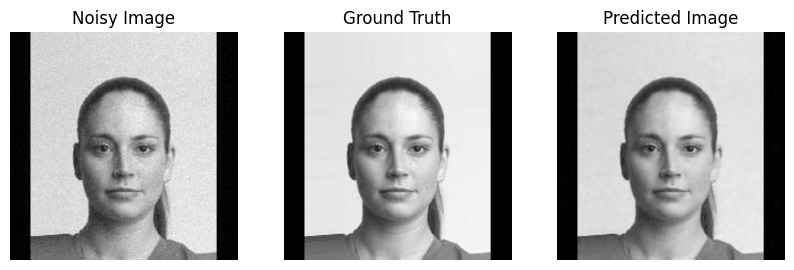

In [ ]:
# Predicción sobre el conjunto de prueba
predicted_clean_test = model.predict(imagen_con_canal)

# Visualización de las primeras 8 imágenes
n = 2
plt.figure(figsize=(10, 10))

display_list = [noisy_images_test[n], original_images_test[n], predicted_clean_test[n]]
title = ['Noisy Image', 'Ground Truth', 'Predicted Image']

for i in range(3):
      plt.subplot(1, 3, i+1)
      plt.title(title[i])
      plt.imshow(display_list[i], cmap='gray')
      plt.axis('off')

In [ ]:
# Guardar el modelo en formato TensorFlow SavedModel (recomendado para TensorFlow 2.x)
dncnn.model.save('denoising_model/models/dncnn_final_model_savedmodel')

# O guardar en formato H5 (compatible con versiones anteriores)
dncnn.model.save('denoising_model/models/dncnn_final_model.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# %load_ext tensorboard
# %tensorboard --logdir toni_runs

In [ ]:
# torch.cuda.empty_cache()

## Comparación de imágenes del dataset propio

In [ ]:
img_path = '/content/ab.png'

def load_and_resize_image(img_path):
    with Image.open(img_path) as img:
        img = img.resize((256, 256))
        img = img.convert('L')
        return img

img = load_and_resize_image(img_path)
img.show()
img.save('/content/img_1.png')

1/1 [==============================] - 0s 172ms/step


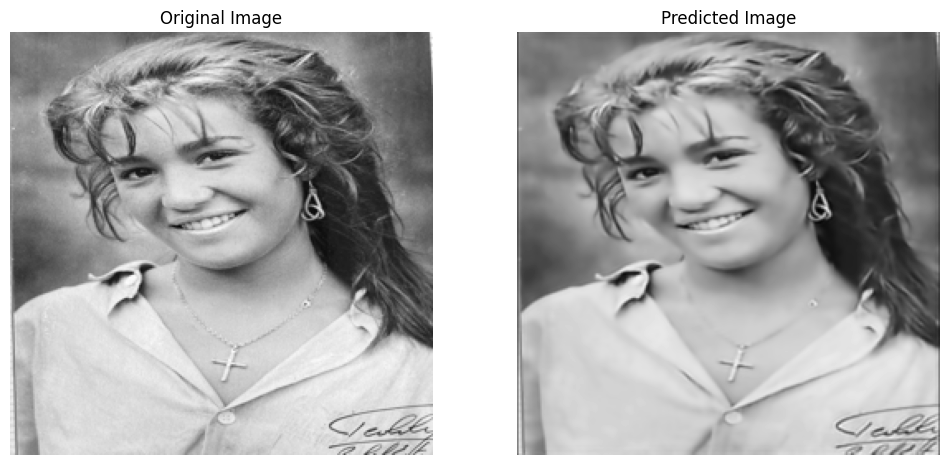

In [ ]:
from PIL import Image
import numpy as np
from keras.models import load_model
import matplotlib.pyplot as plt

def load_and_prepare_image(image_path):
    with Image.open(image_path) as img:
        img = img.resize((256, 256))
        img = img.convert('L')
        img_array = np.array(img)
        # img_array = img_array / 255.0  # Normalización
        img_array = img_array.reshape(1, 256, 256, 1)  # Ajustar a las dimensiones esperadas por el modelo
        return img_array

# Cargar el modelo
model = load_model('/content/denoising_model/models/dncnn_final_model.h5')

# Cargar, preparar y normalizar la imagen
image_path = '/content/img_1.png'
img = load_and_prepare_image(image_path)

# Hacer la predicción
prediction = model.predict(img)

# Asegúrate de eliminar la dimensión del batch si es necesario
predicted_img = prediction.squeeze()  # Esto elimina dimensiones de tamaño 1, como (1, 256, 256, 1) a (256, 256)

# Asumiendo que los datos están normalizados entre 0 y 1, escalarlos a 0-255
predicted_img = predicted_img

# Crear un subplot para mostrar ambas imágenes
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img.squeeze(), cmap='gray')  # Asegúrate de usar squeeze aquí también si es necesario
axes[0].set_title('Original Image')
axes[0].axis('off')  # Ocultar los ejes

axes[1].imshow(predicted_img, cmap='gray')
axes[1].set_title('Predicted Image')
axes[1].axis('off')  # Ocultar los ejes

plt.show()

In [ ]:
def save_image(image_array, file_path):
    # Convertir la matriz a un objeto de imagen
    img = Image.fromarray(image_array)
    # Guardar la imagen en el formato deseado
    img.save(file_path)

In [ ]:
save_image(predicted_img.astype(np.uint8), '/content/prediction.png')

In [ ]:
def plot_images(model_path, image_path):
  model = load_model(model_path)
  img = load_and_prepare_image(image_path)
  # Hacer la predicción
  prediction = model.predict(img)

  # Asegúrate de eliminar la dimensión del batch si es necesario
  predicted_img = prediction.squeeze()  # Esto elimina dimensiones de tamaño 1, como (1, 256, 256, 1) a (256, 256)

  # Asumiendo que los datos están normalizados entre 0 y 1, escalarlos a 0-255
  predicted_img = predicted_img

  # Crear un subplot para mostrar ambas imágenes
  fig, axes = plt.subplots(1, 2, figsize=(12, 6))
  axes[0].imshow(img.squeeze(), cmap='gray')  # Asegúrate de usar squeeze aquí también si es necesario
  axes[0].set_title('Original Image')
  axes[0].axis('off')  # Ocultar los ejes

  axes[1].imshow(predicted_img, cmap='gray')
  axes[1].set_title('Predicted Image')
  axes[1].axis('off')  # Ocultar los ejes

  plt.show()
  return predicted_img


1/1 [==============================] - 0s 189ms/step


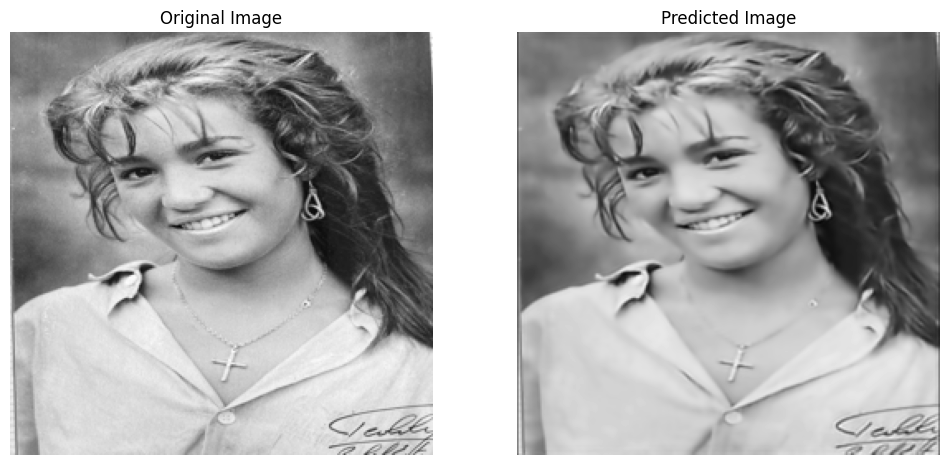

1/1 [==============================] - 0s 182ms/step


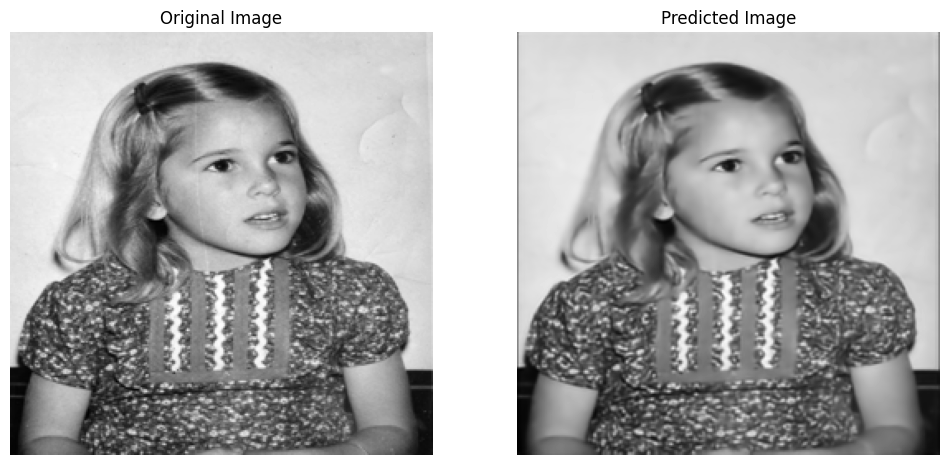

In [ ]:
plot_images('/content/denoising_model/models/dncnn_final_model.h5', '/content/img_1.png')
plot_images('/content/denoising_model/models/dncnn_final_model.h5', '/content/img_2.png')

1/1 [==============================] - 0s 192ms/step


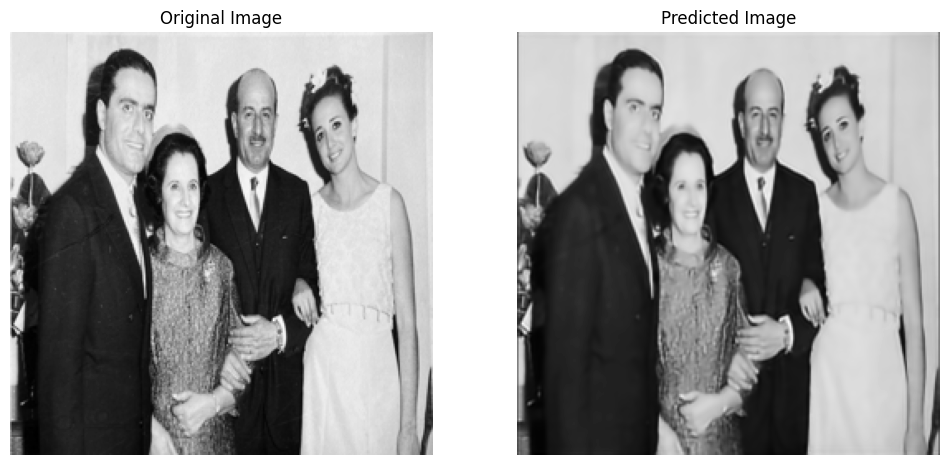

1/1 [==============================] - 0s 226ms/step


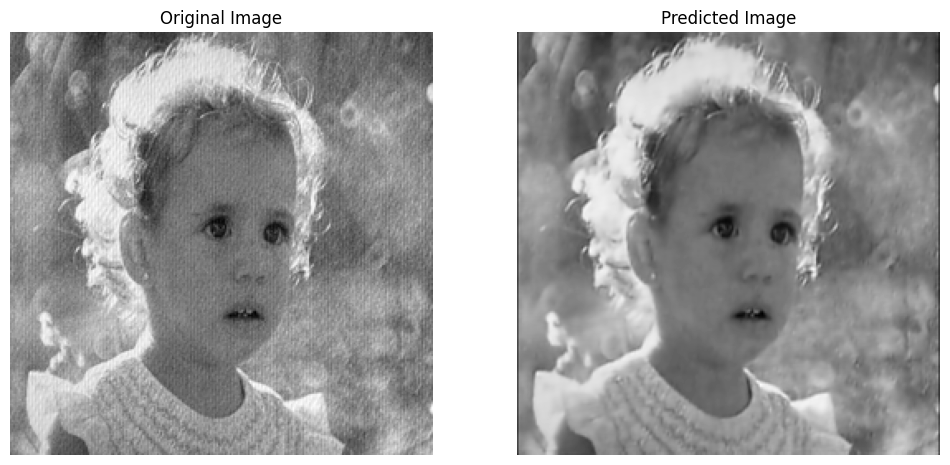

1/1 [==============================] - 0s 218ms/step


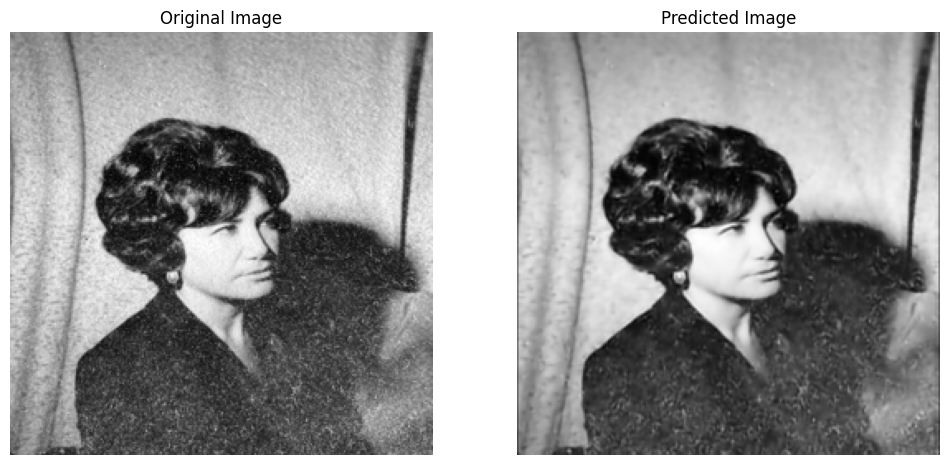

In [ ]:
plot_images('/content/denoising_model/models/dncnn_final_model.h5', '/content/img_3.png')
plot_images('/content/denoising_model/models/dncnn_final_model.h5', '/content/img_4.png')
plot_images('/content/denoising_model/models/dncnn_final_model.h5', '/content/img_5.png')

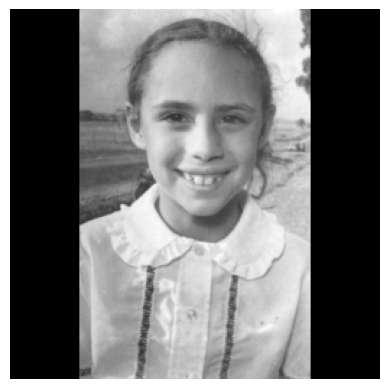

In [ ]:
# plot image from png
def plot_image(image_path):
    image = Image.open(image_path).convert("L")
    plt.imshow(image, cmap="gray")
    plt.axis("off")
    plt.show()
    return image

img_1 = plot_image('/content/denoising_model/images/IMG_4643.png')

In [ ]:
# image size
print("shape:", np.shape(img_1))
print("min pixel value:", np.min(img_1))
print("max pixel value:", np.max(img_1))

shape: (256, 256)
min pixel value: 0
max pixel value: 237


In [ ]:
# plot image and prediction
def plot_predicted_original(model_path, image_path):
  model = load_model(model_path)
  img = Image.open(image_path).convert("L")

  img_array = np.array(img)
  img_array = img_array.reshape(1, 256, 256, 1)  # Ajustar a las dimensiones esperadas por el modelo

  # Hacer la predicción
  prediction = model.predict(img_array)
  predicted_img = prediction.squeeze()  # Esto elimina dimensiones de tamaño 1, como (1, 256, 256, 1) a (256, 256)

  # Crear un subplot para mostrar ambas imágenes
  fig, axes = plt.subplots(1, 2, figsize=(12, 6))
  axes[0].imshow(img, cmap='gray')  # Asegúrate de usar squeeze aquí también si es necesario
  axes[0].set_title('Original Image')
  axes[0].axis('off')  # Ocultar los ejes

  axes[1].imshow(predicted_img, cmap='gray')
  axes[1].set_title('Predicted Image')
  axes[1].axis('off')  # Ocultar los ejes

  plt.show()
  return predicted_img

1/1 [==============================] - 0s 176ms/step


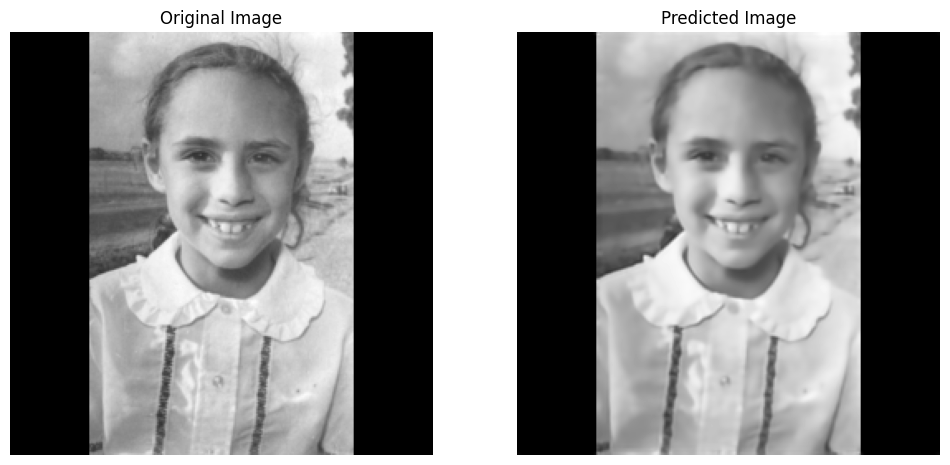

In [ ]:
predicted_img = plot_predicted_original('/content/denoising_model/models/dncnn_final_model.h5', '/content/denoising_model/images/IMG_4643.png')

1/1 [==============================] - 0s 181ms/step


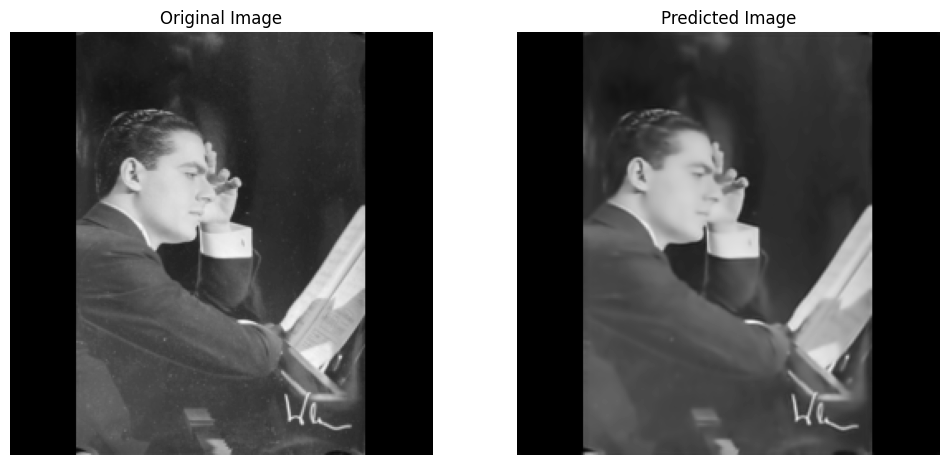

1/1 [==============================] - 0s 180ms/step


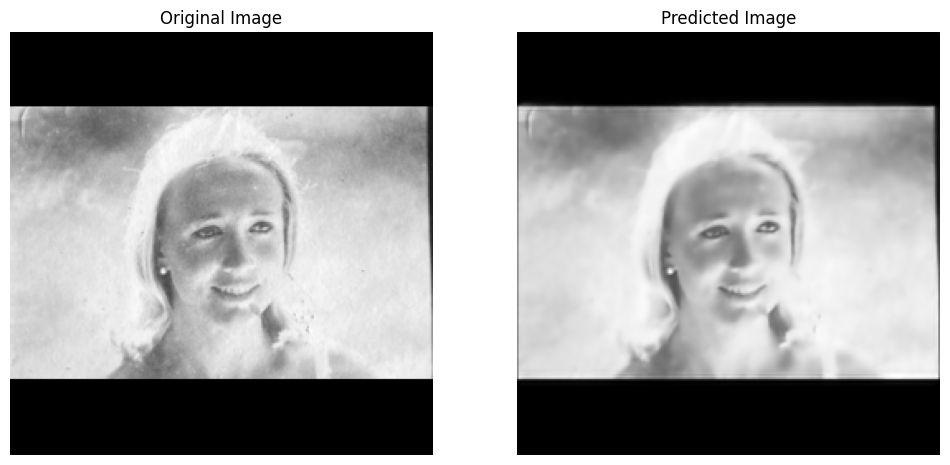

1/1 [==============================] - 0s 181ms/step


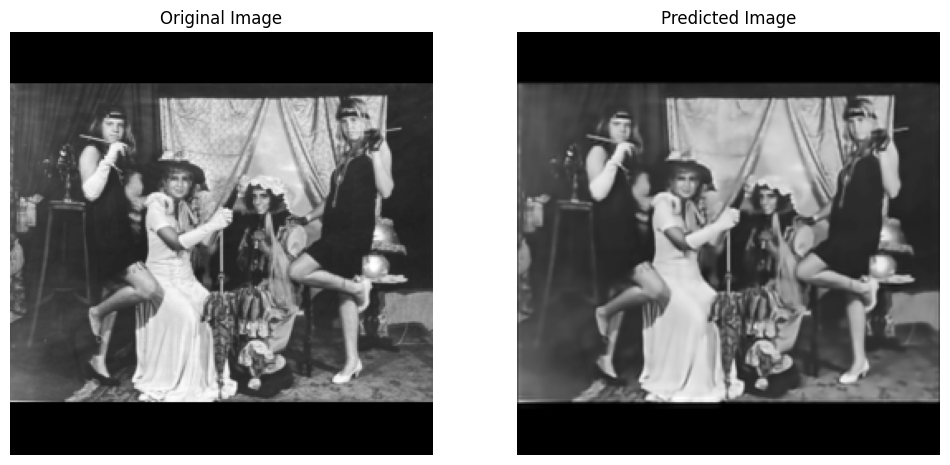

1/1 [==============================] - 0s 177ms/step


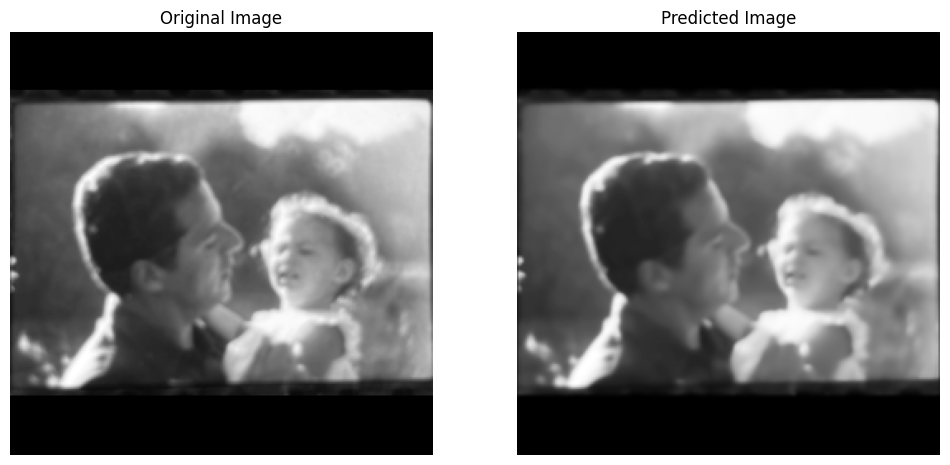

1/1 [==============================] - 0s 180ms/step


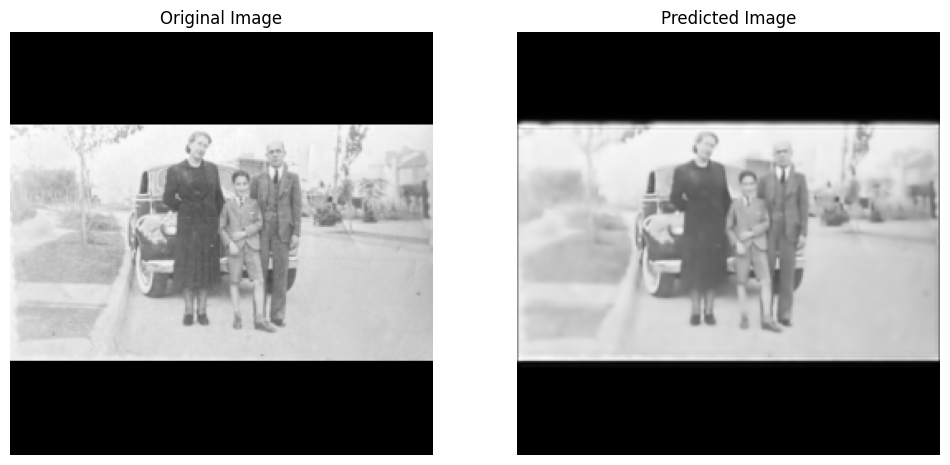

1/1 [==============================] - 0s 176ms/step


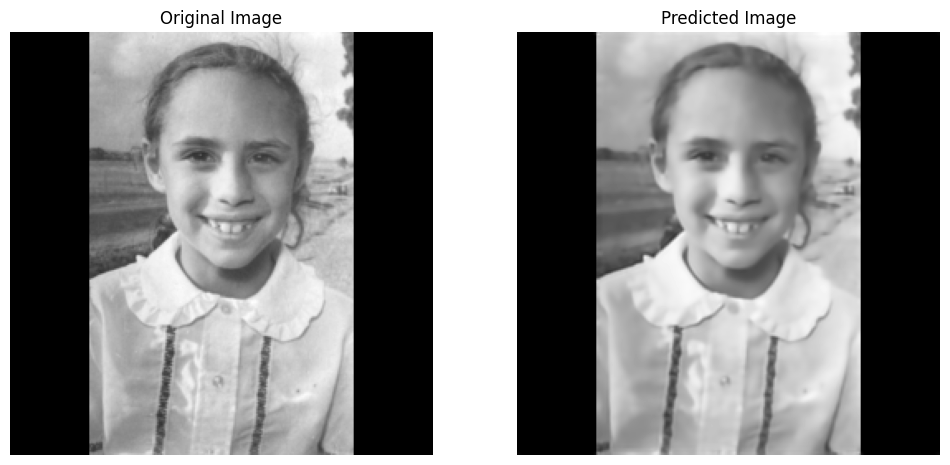

1/1 [==============================] - 0s 176ms/step


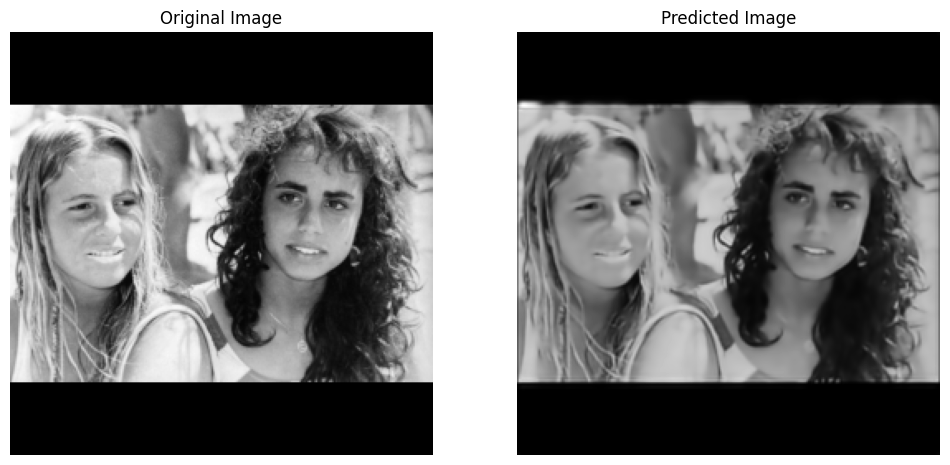

1/1 [==============================] - 0s 178ms/step


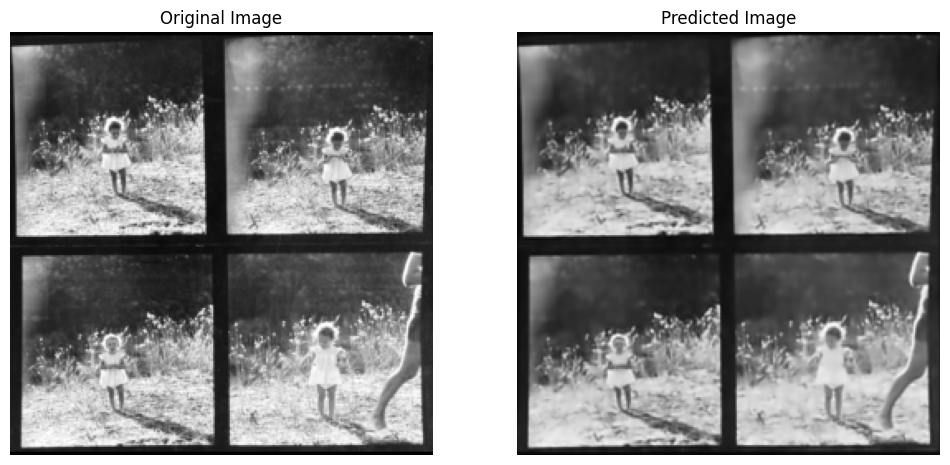

1/1 [==============================] - 0s 179ms/step


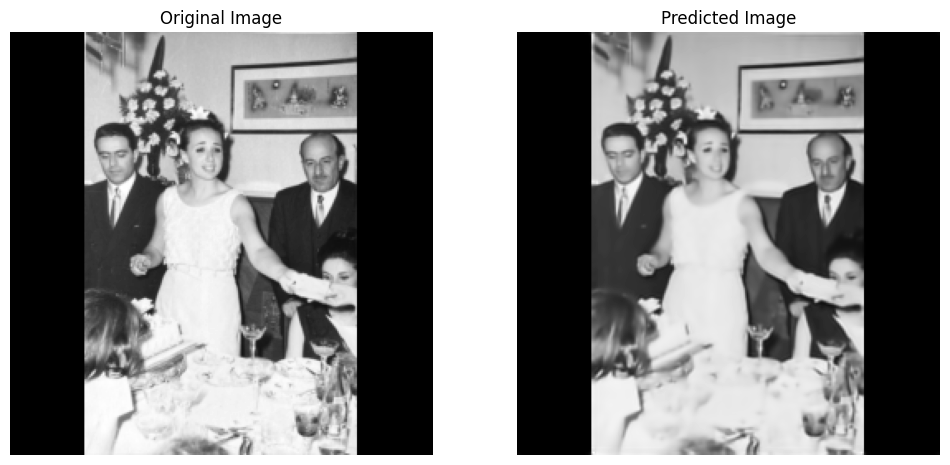

1/1 [==============================] - 0s 177ms/step


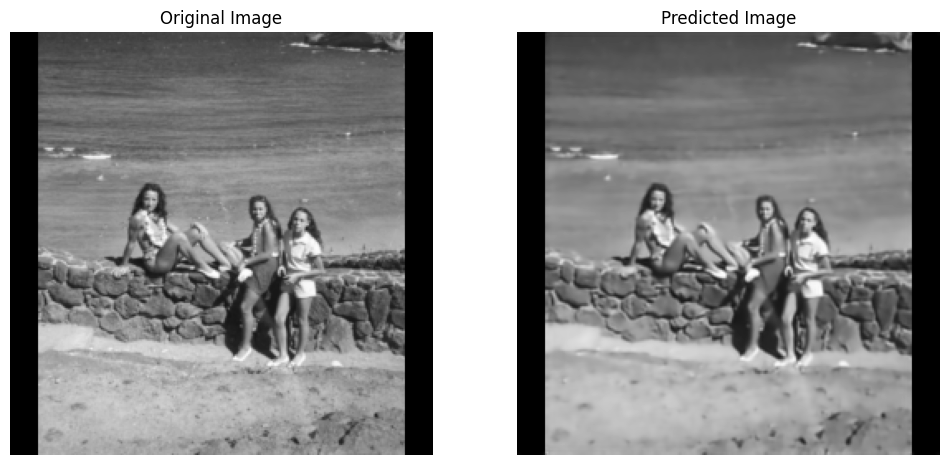

1/1 [==============================] - 0s 176ms/step


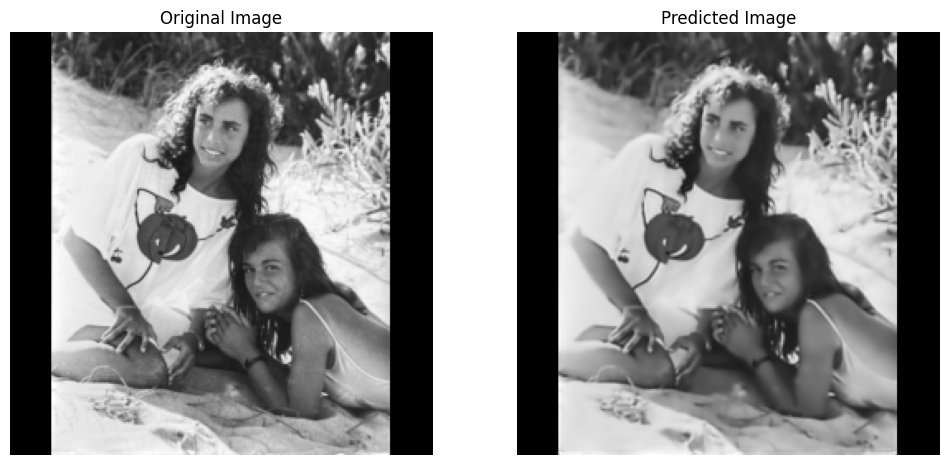

1/1 [==============================] - 0s 176ms/step


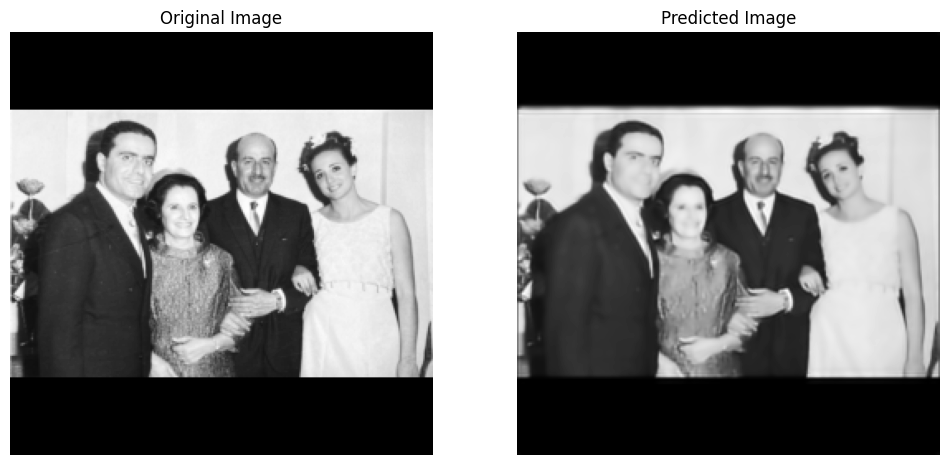

1/1 [==============================] - 0s 182ms/step


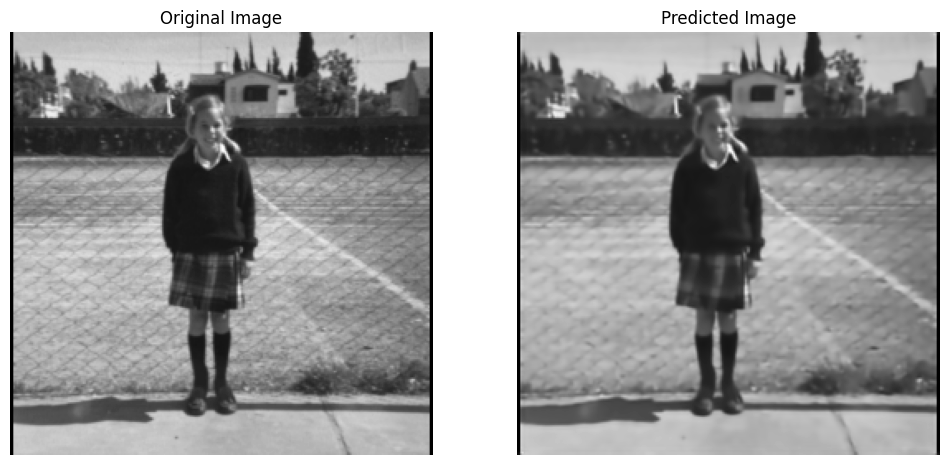

1/1 [==============================] - 0s 177ms/step


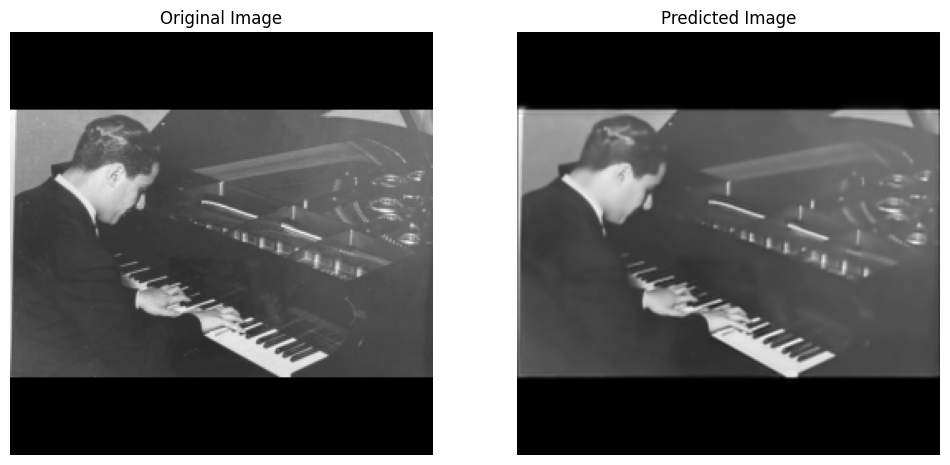

1/1 [==============================] - 0s 181ms/step


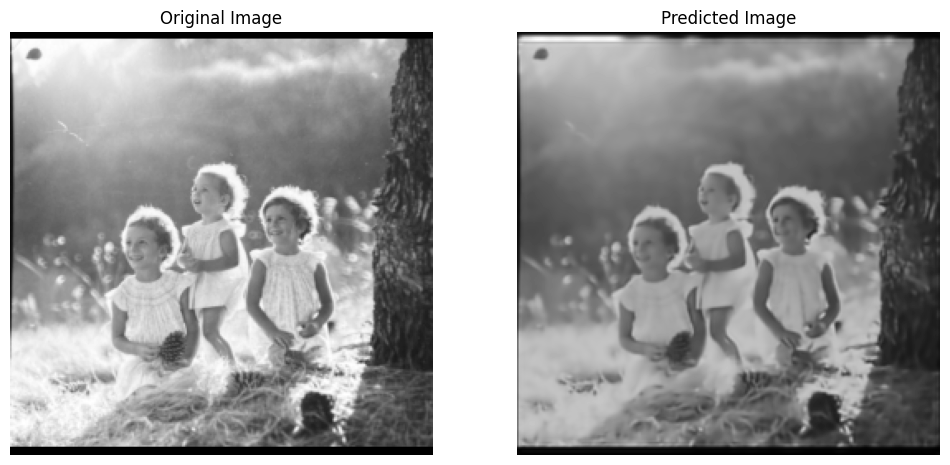

1/1 [==============================] - 0s 179ms/step


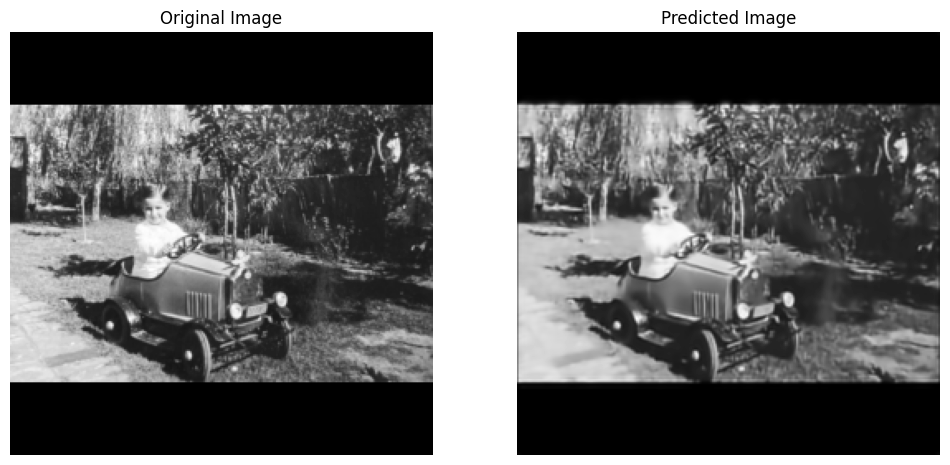

1/1 [==============================] - 0s 176ms/step


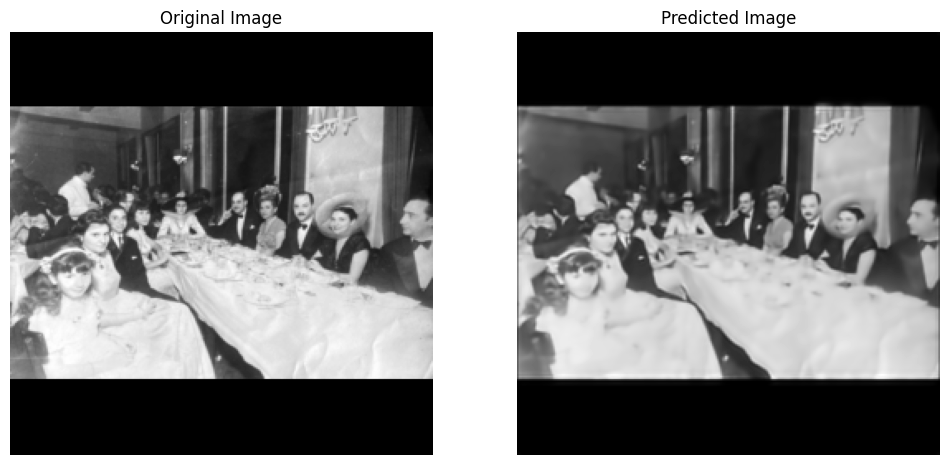

1/1 [==============================] - 0s 180ms/step


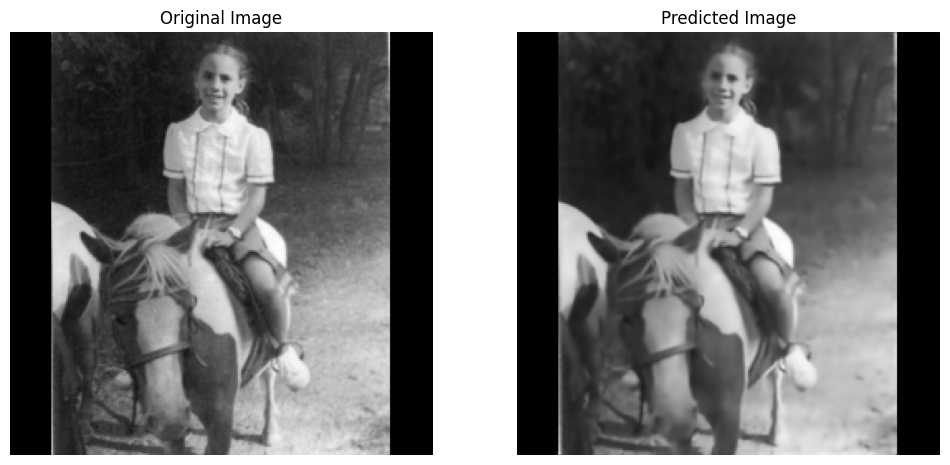

1/1 [==============================] - 0s 181ms/step


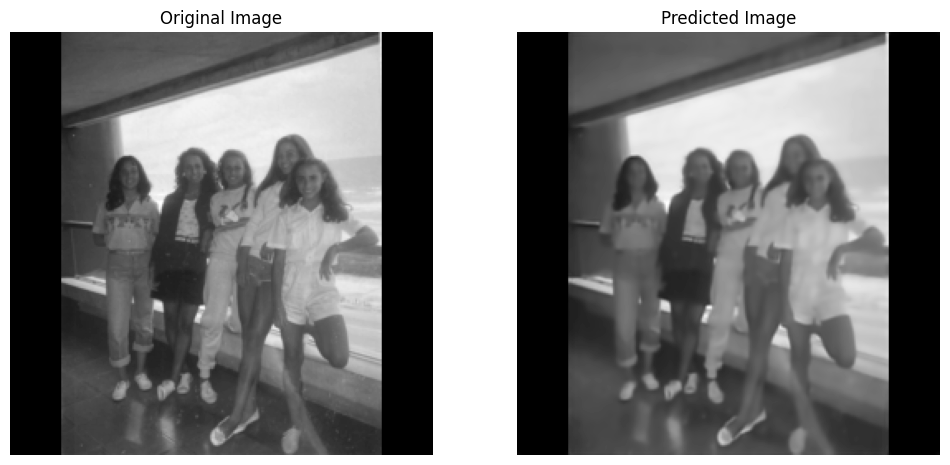

1/1 [==============================] - 0s 179ms/step


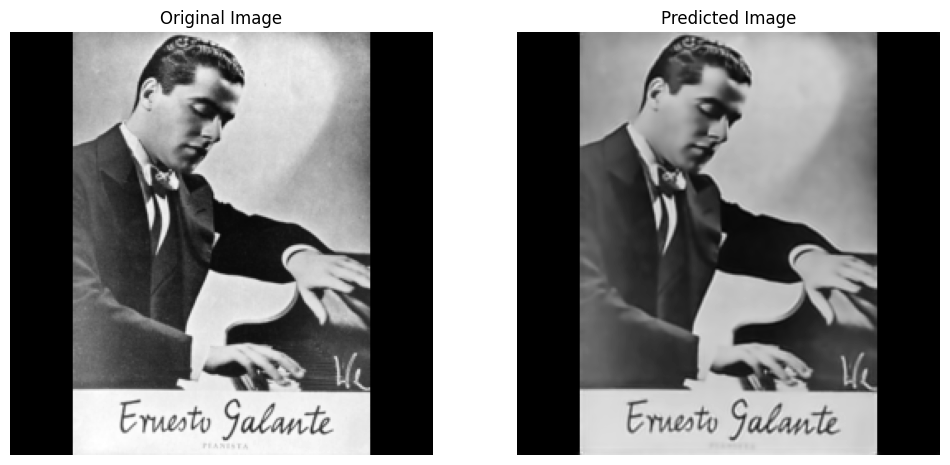

1/1 [==============================] - 0s 178ms/step


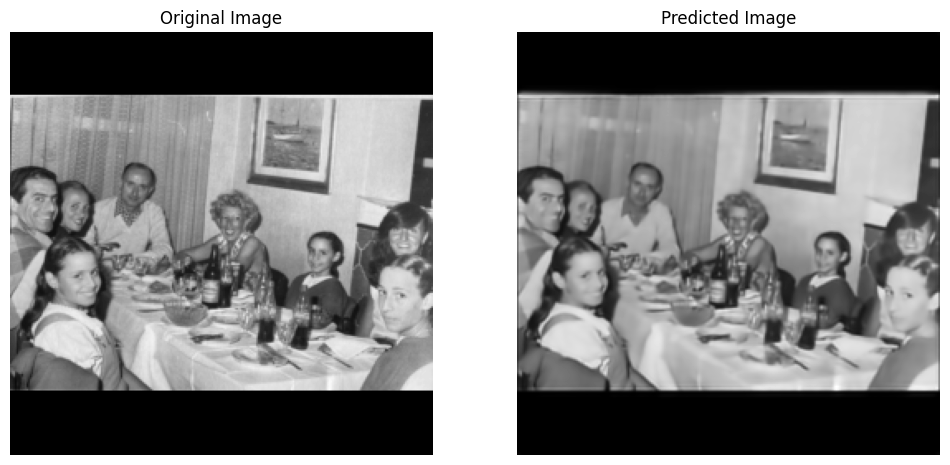

1/1 [==============================] - 0s 179ms/step


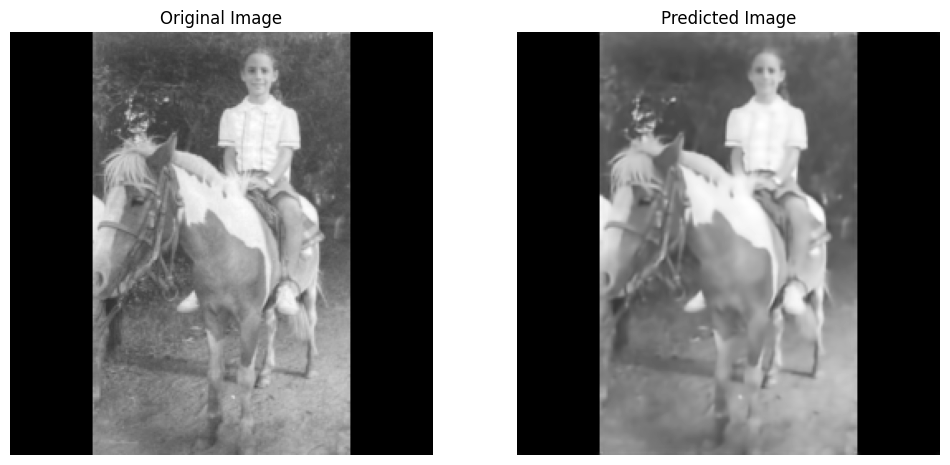

1/1 [==============================] - 0s 177ms/step


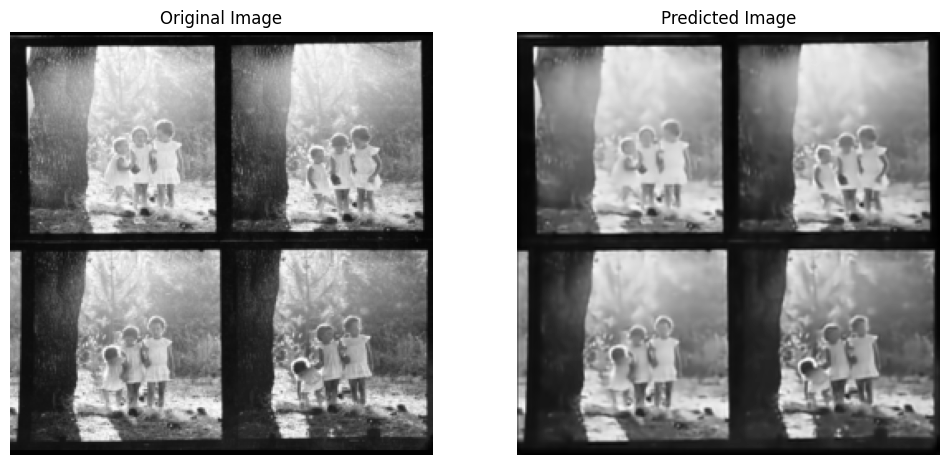

1/1 [==============================] - 0s 176ms/step


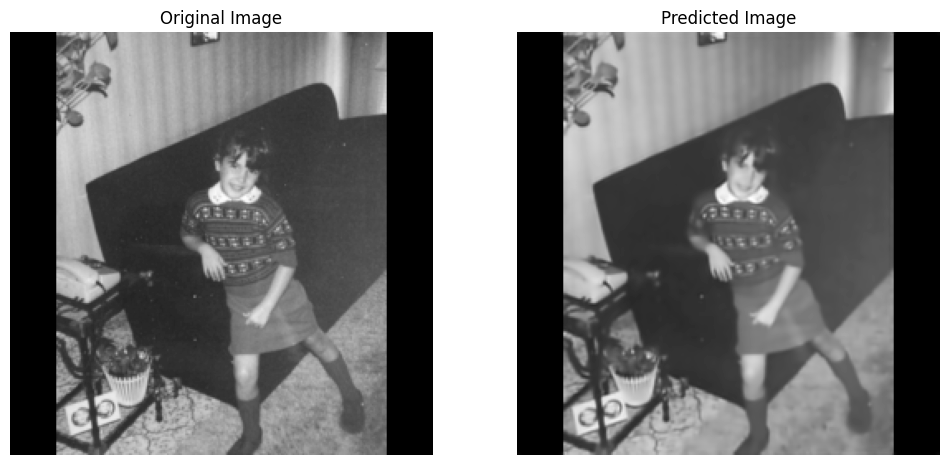

1/1 [==============================] - 0s 177ms/step


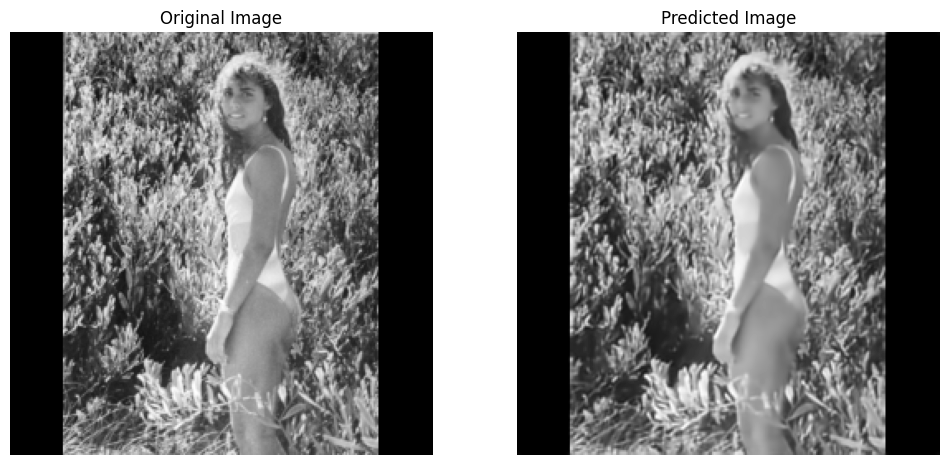

1/1 [==============================] - 0s 187ms/step


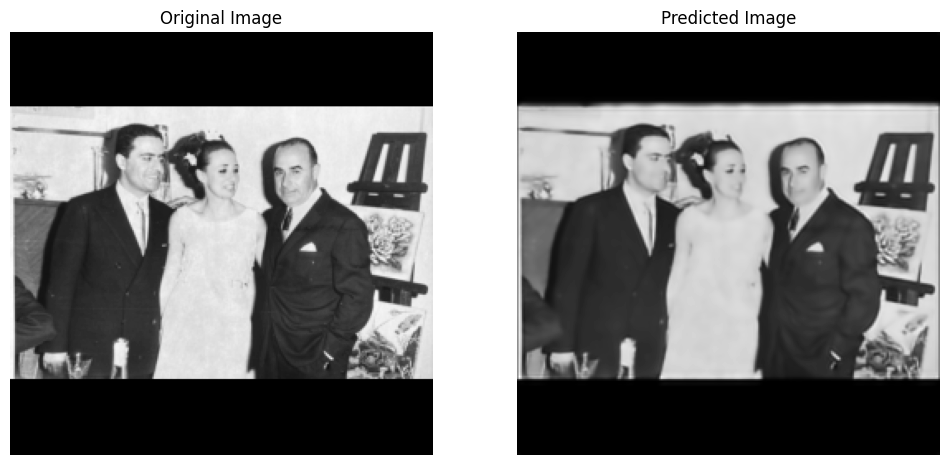

1/1 [==============================] - 0s 180ms/step


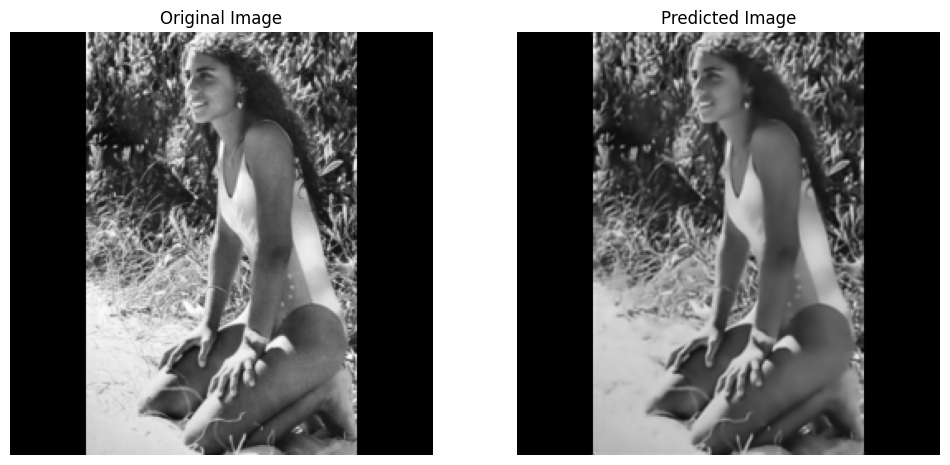

1/1 [==============================] - 0s 177ms/step


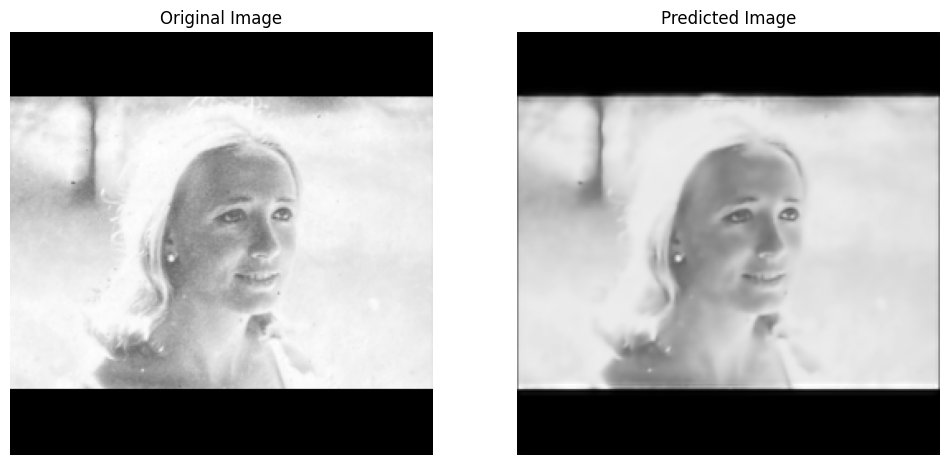

1/1 [==============================] - 0s 177ms/step


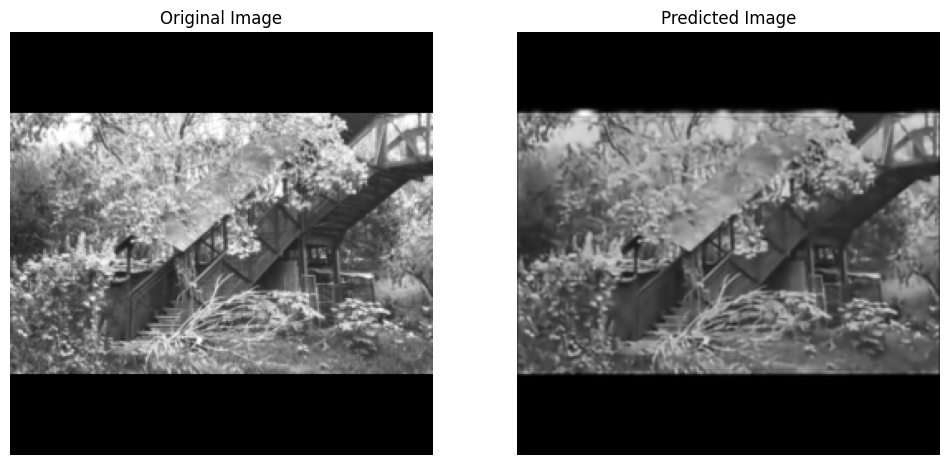

1/1 [==============================] - 0s 178ms/step


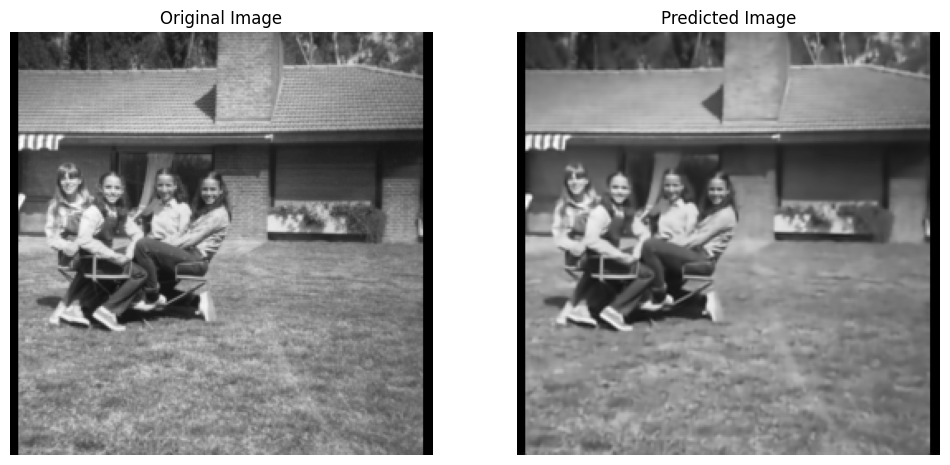

1/1 [==============================] - 0s 177ms/step


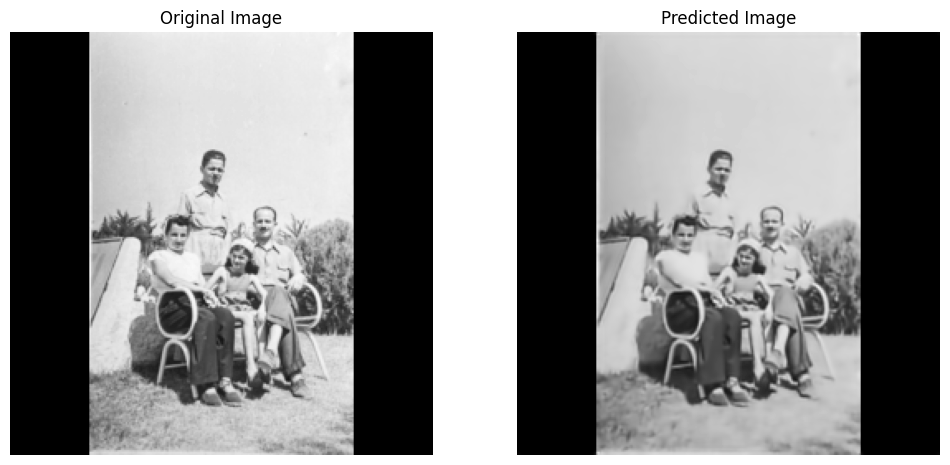

1/1 [==============================] - 0s 179ms/step


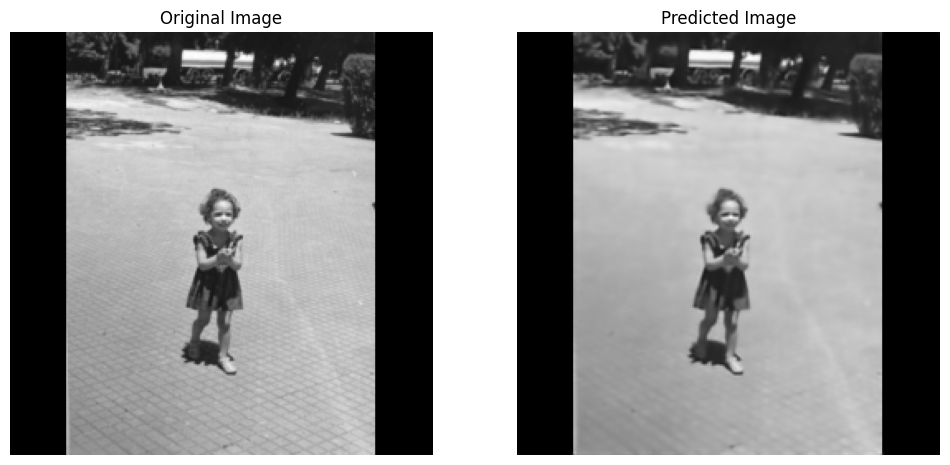

1/1 [==============================] - 0s 176ms/step


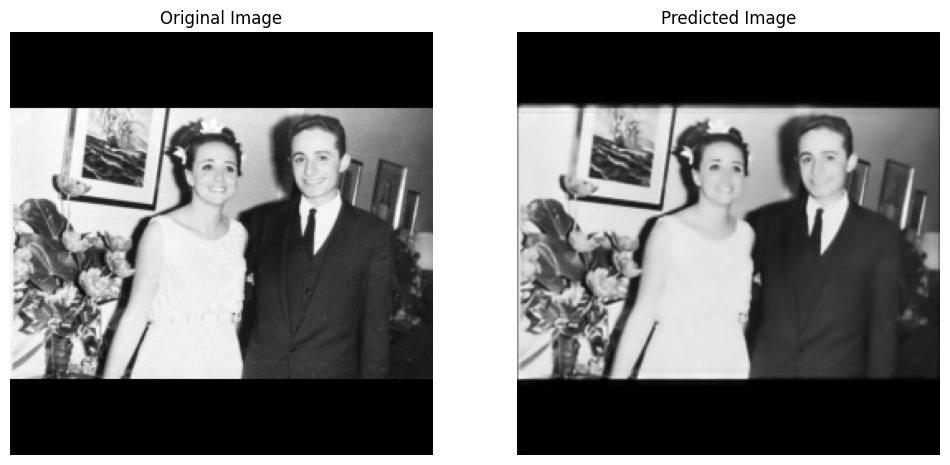

1/1 [==============================] - 0s 177ms/step


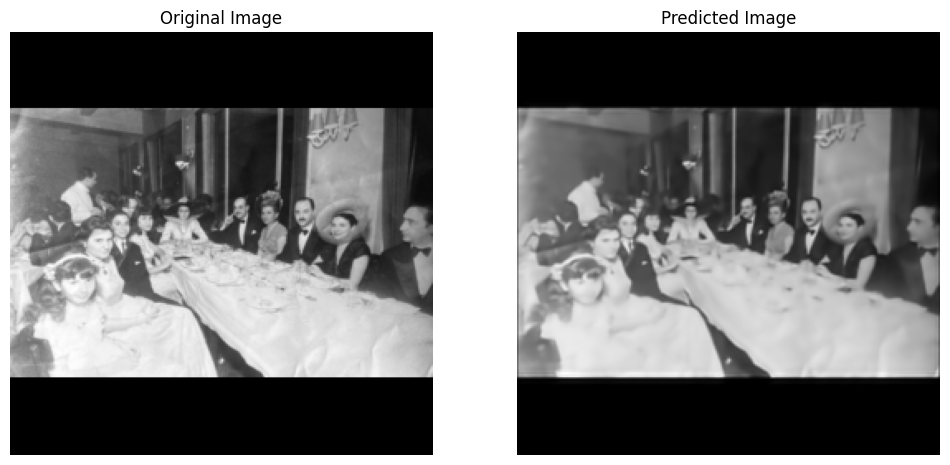

1/1 [==============================] - 0s 176ms/step


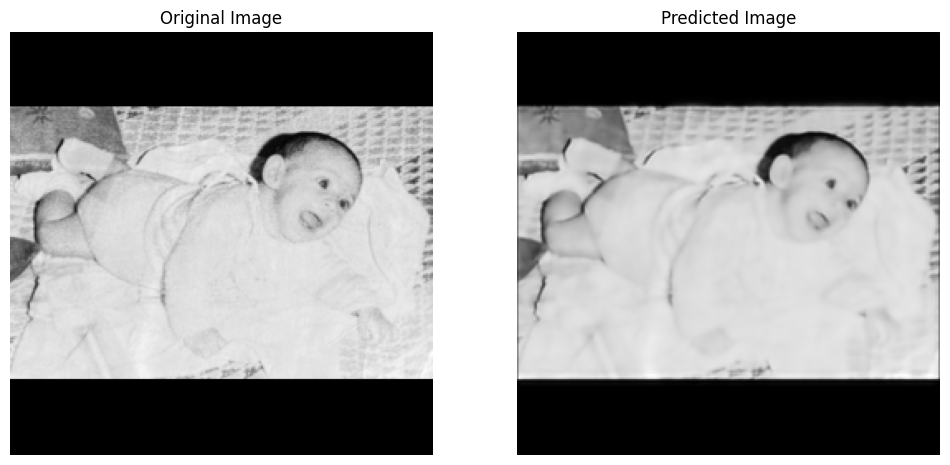

1/1 [==============================] - 0s 177ms/step


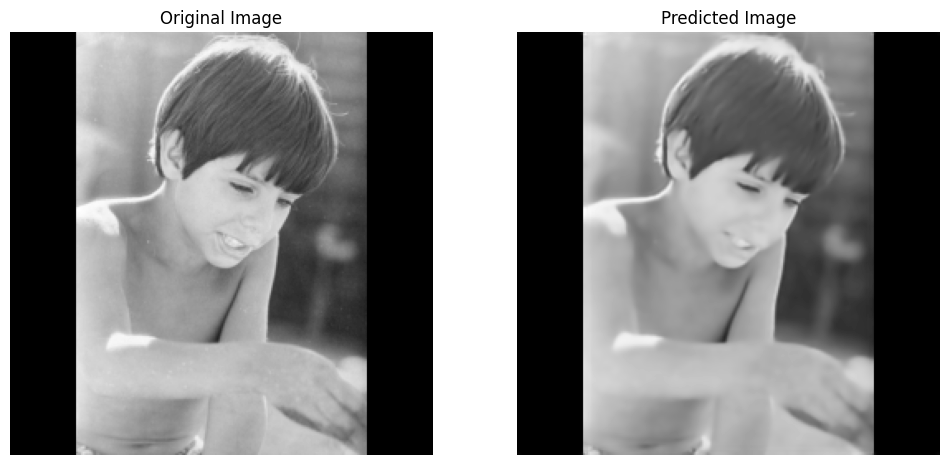

1/1 [==============================] - 0s 176ms/step


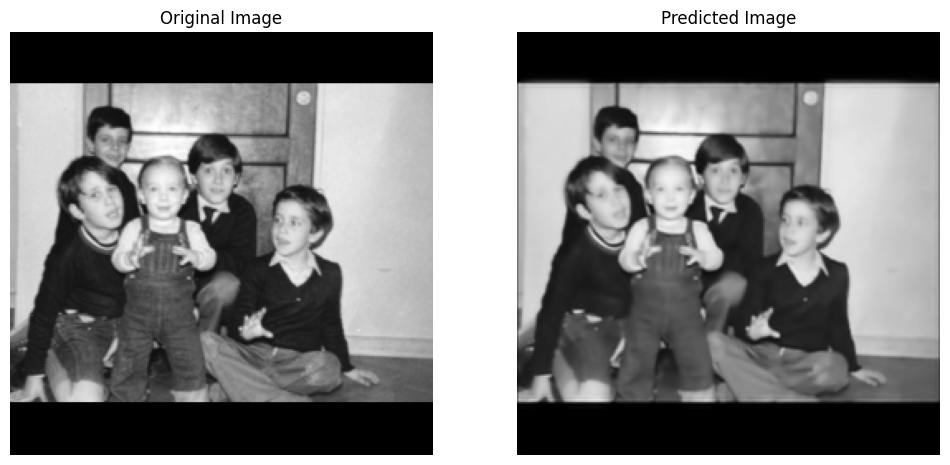

1/1 [==============================] - 0s 174ms/step


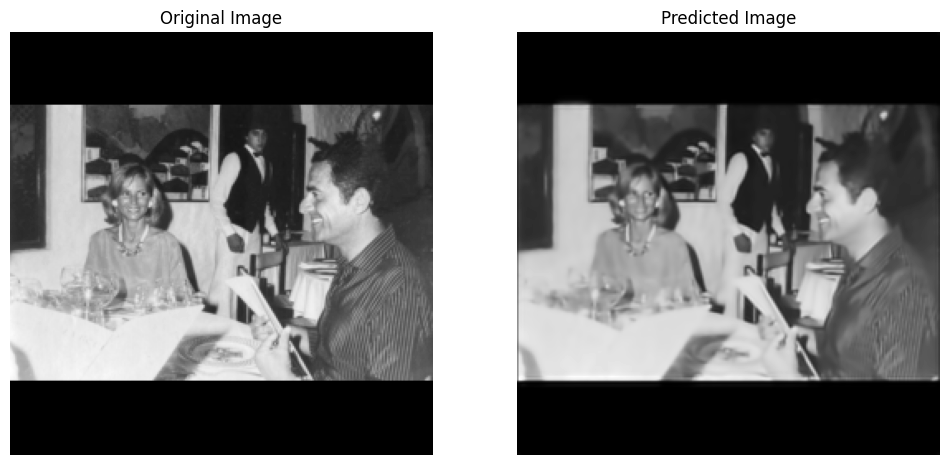

1/1 [==============================] - 0s 182ms/step


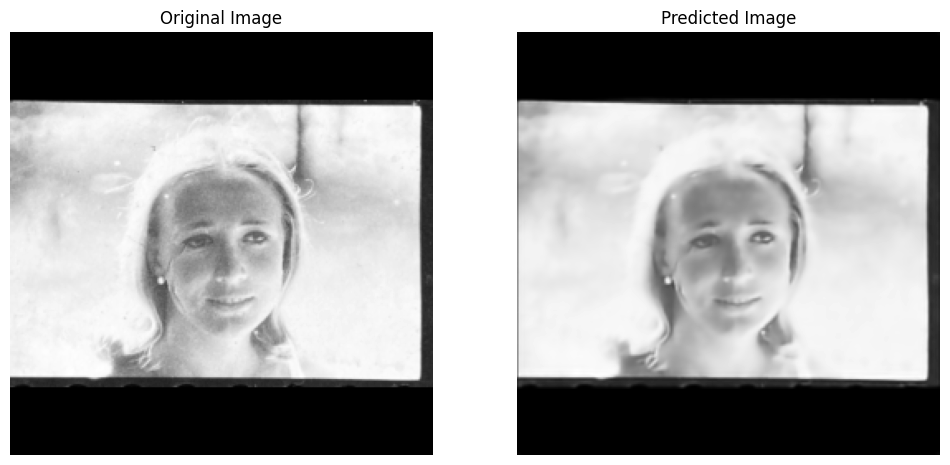

1/1 [==============================] - 0s 180ms/step


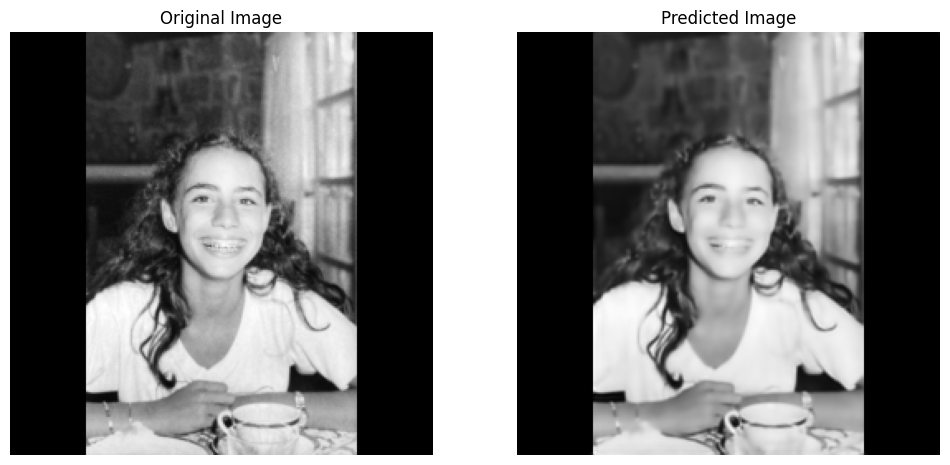

1/1 [==============================] - 0s 180ms/step


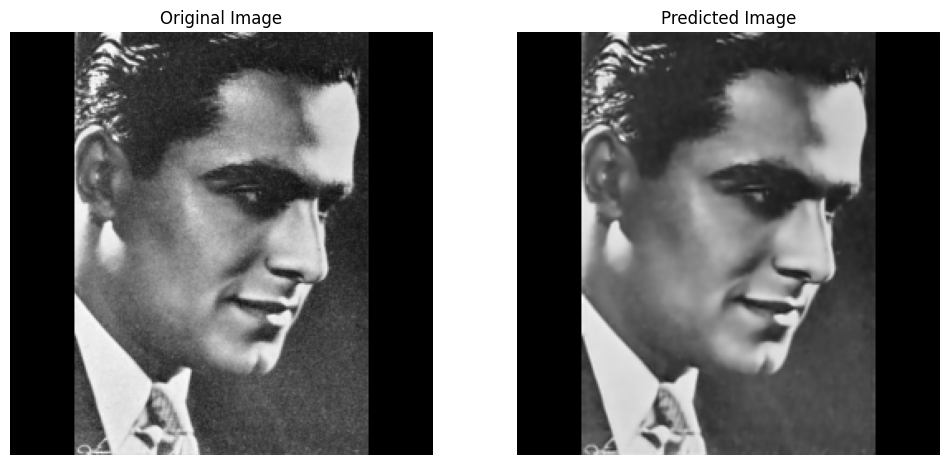

1/1 [==============================] - 0s 177ms/step


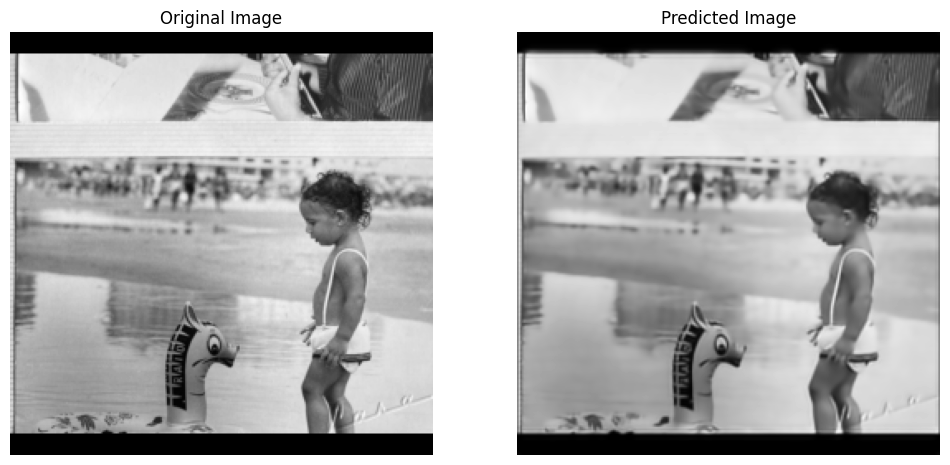

1/1 [==============================] - 0s 178ms/step


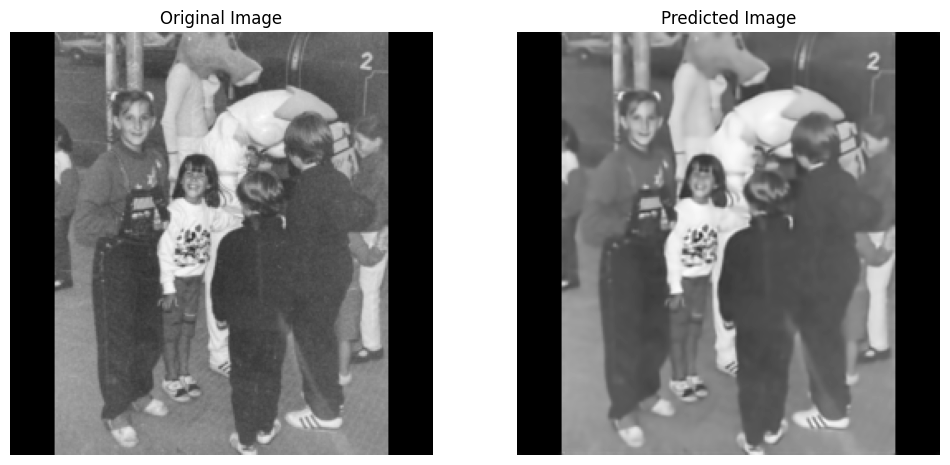

1/1 [==============================] - 0s 182ms/step


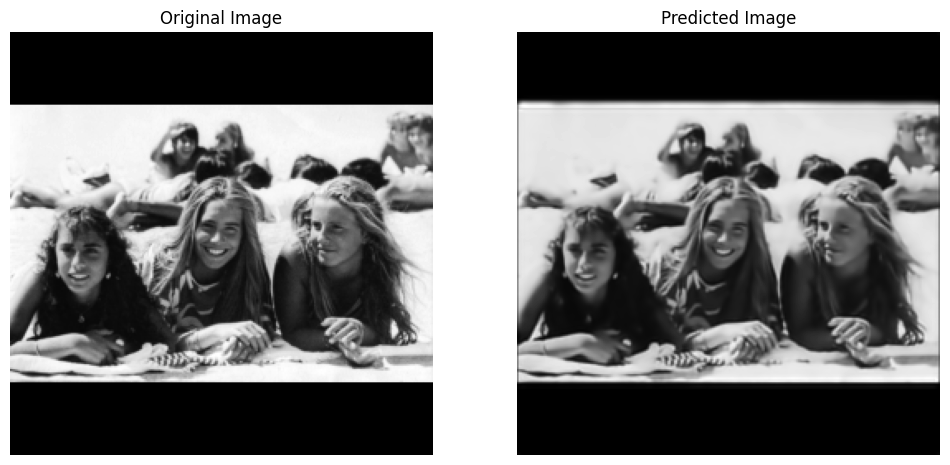

1/1 [==============================] - 0s 180ms/step


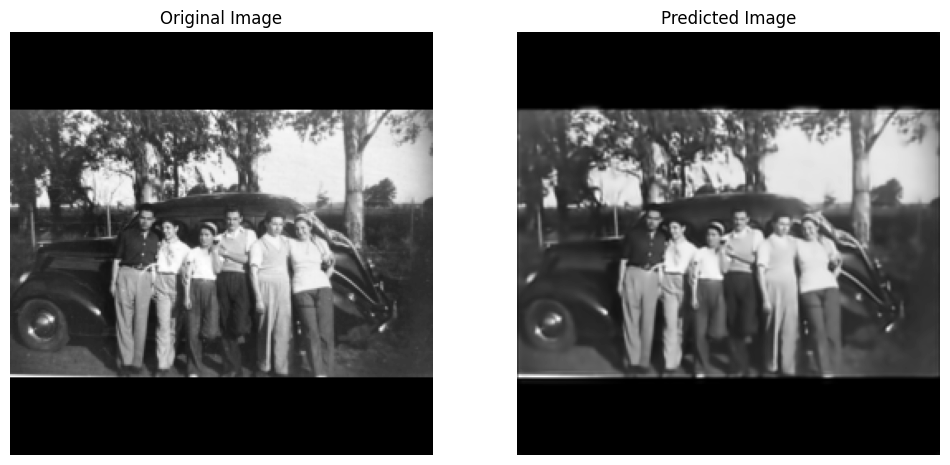

1/1 [==============================] - 0s 177ms/step


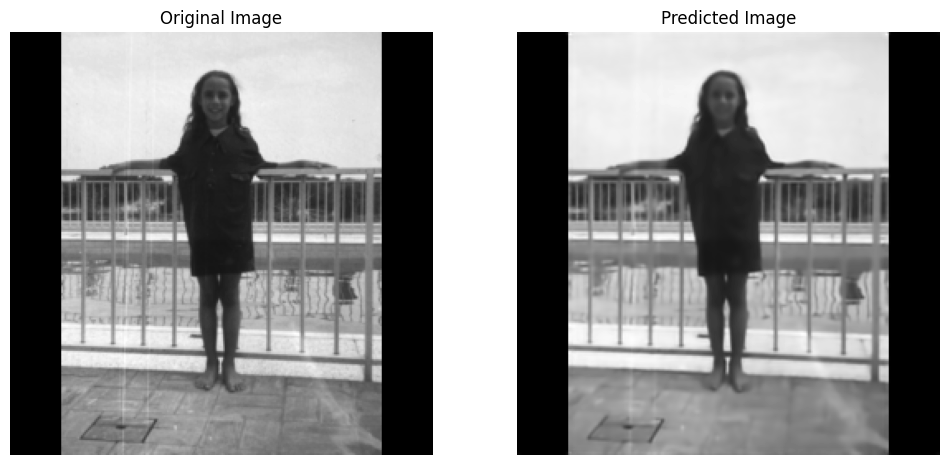

1/1 [==============================] - 0s 175ms/step


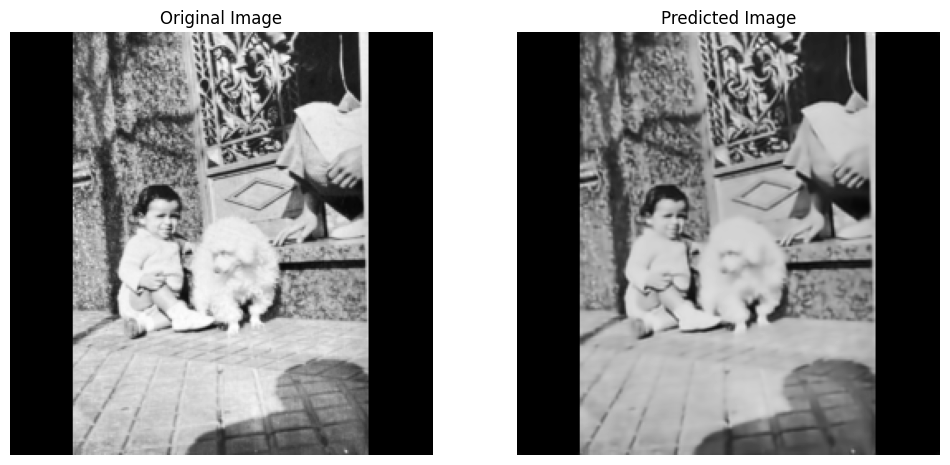

1/1 [==============================] - 0s 175ms/step


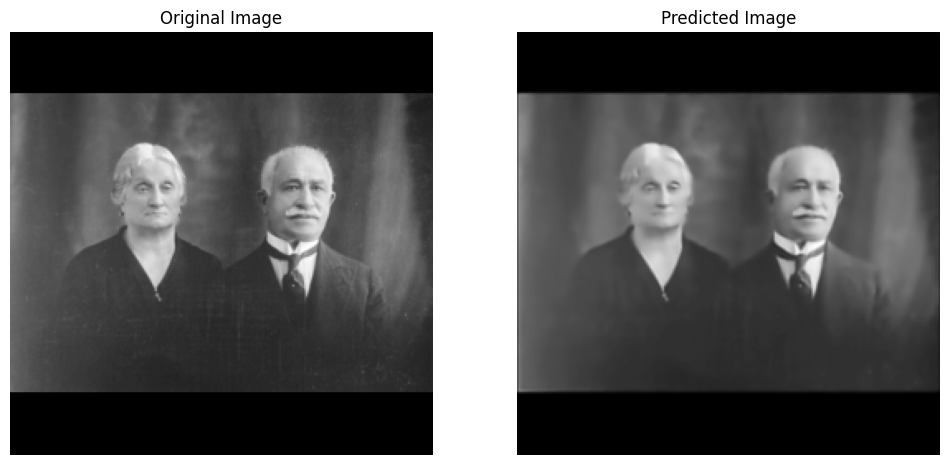

1/1 [==============================] - 0s 176ms/step


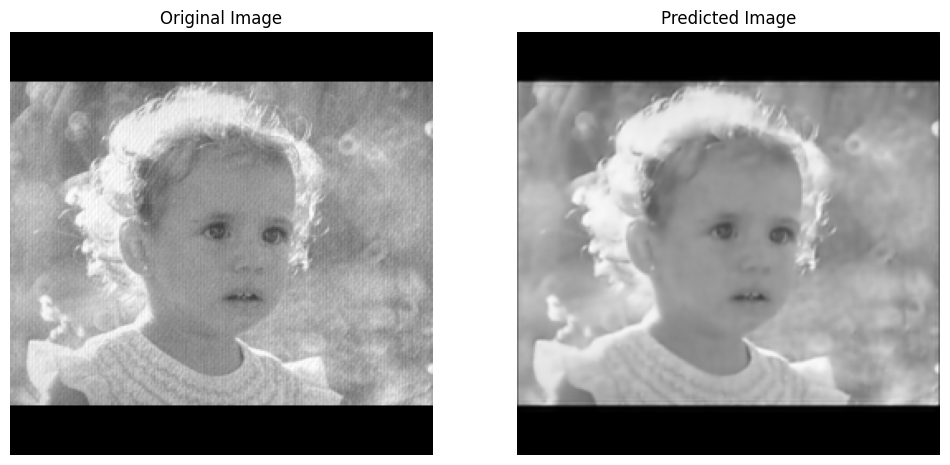

1/1 [==============================] - 0s 179ms/step


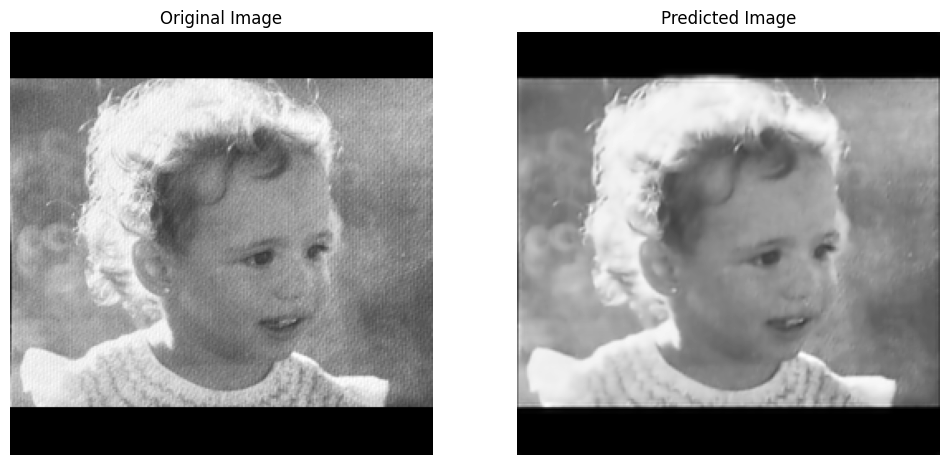

1/1 [==============================] - 0s 177ms/step


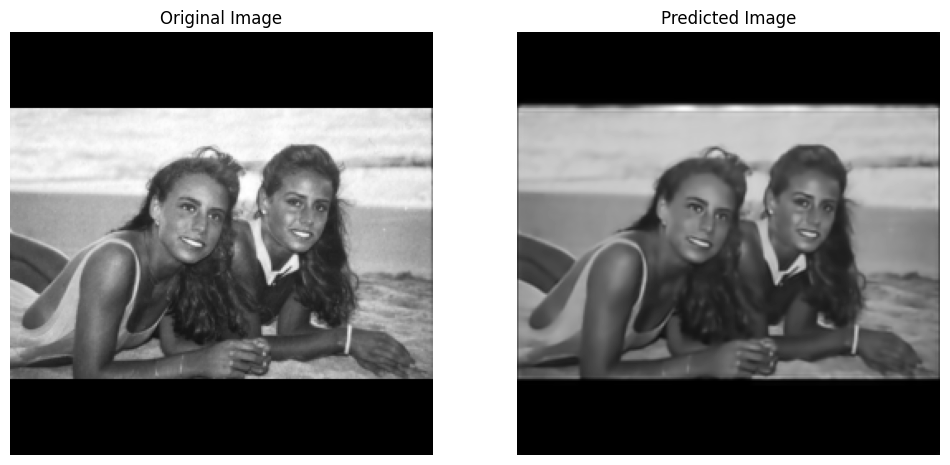

1/1 [==============================] - 0s 187ms/step


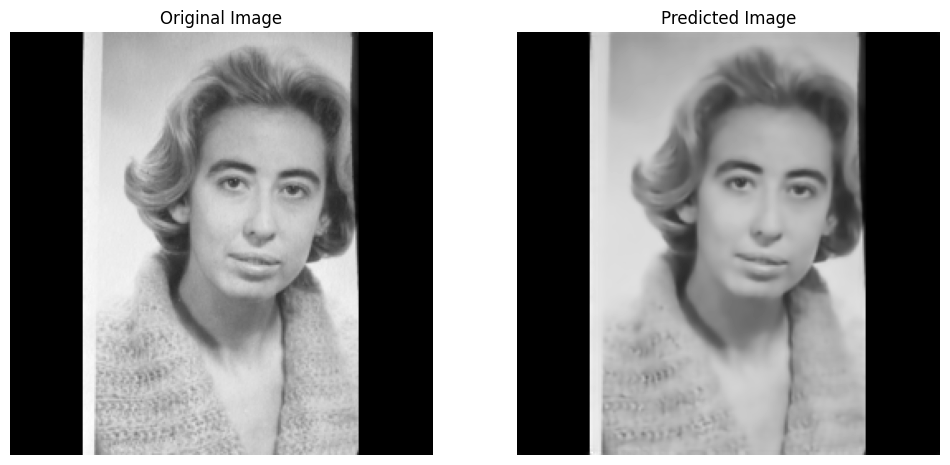

1/1 [==============================] - 0s 180ms/step


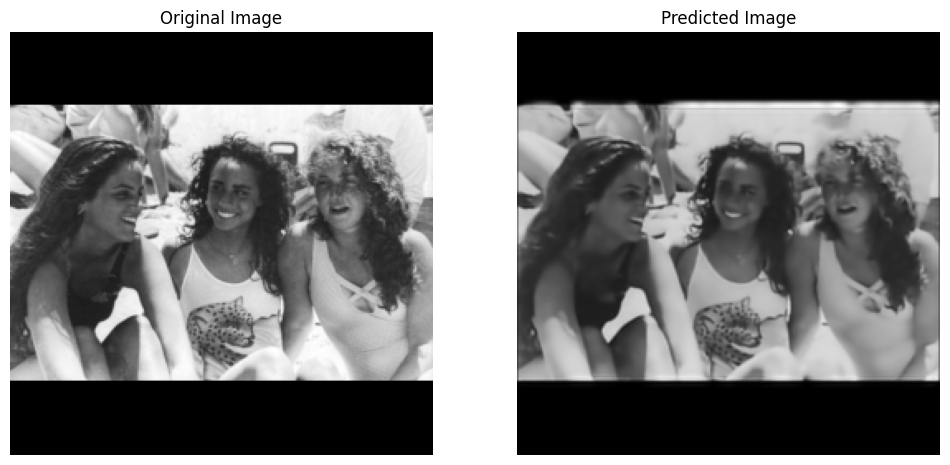

1/1 [==============================] - 0s 182ms/step


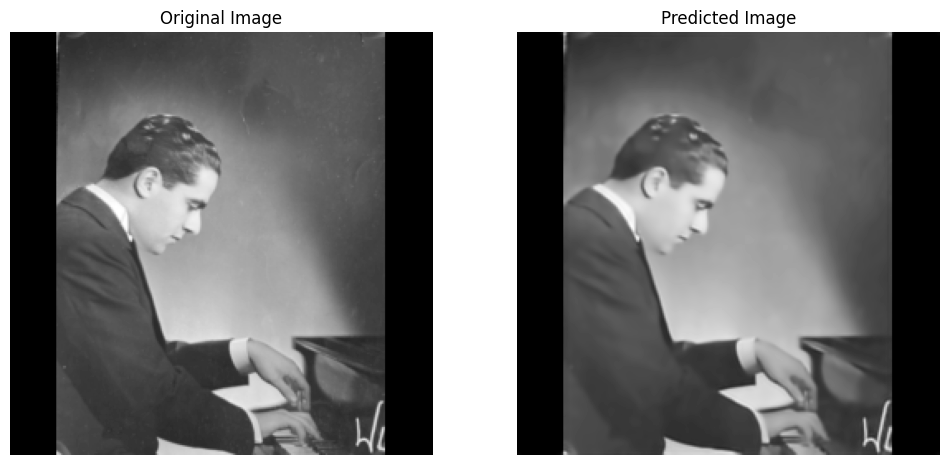

1/1 [==============================] - 0s 179ms/step


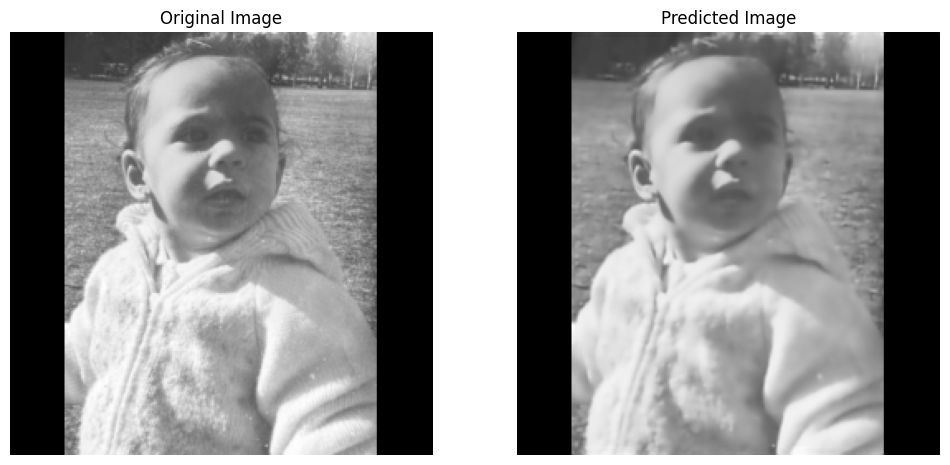

1/1 [==============================] - 0s 178ms/step


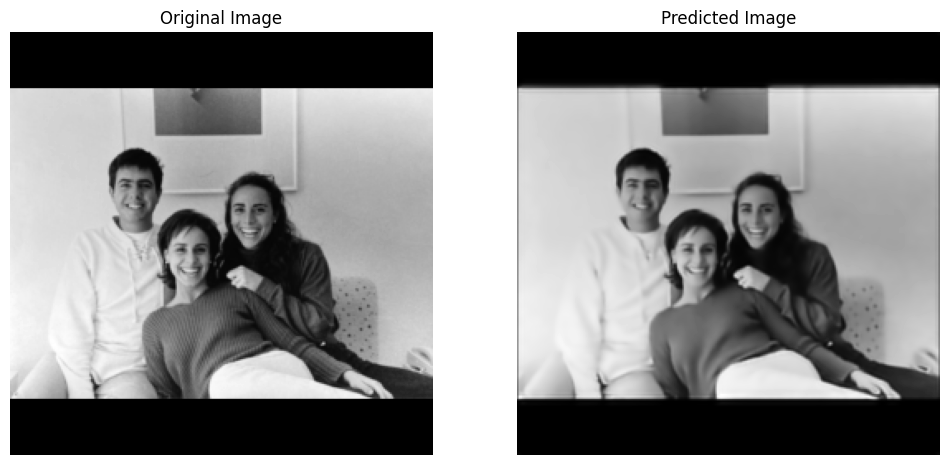

1/1 [==============================] - 0s 178ms/step


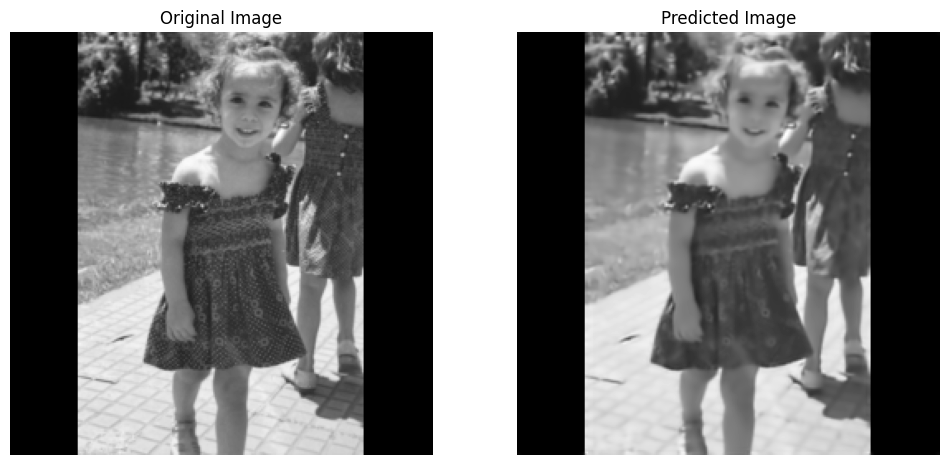

1/1 [==============================] - 0s 179ms/step


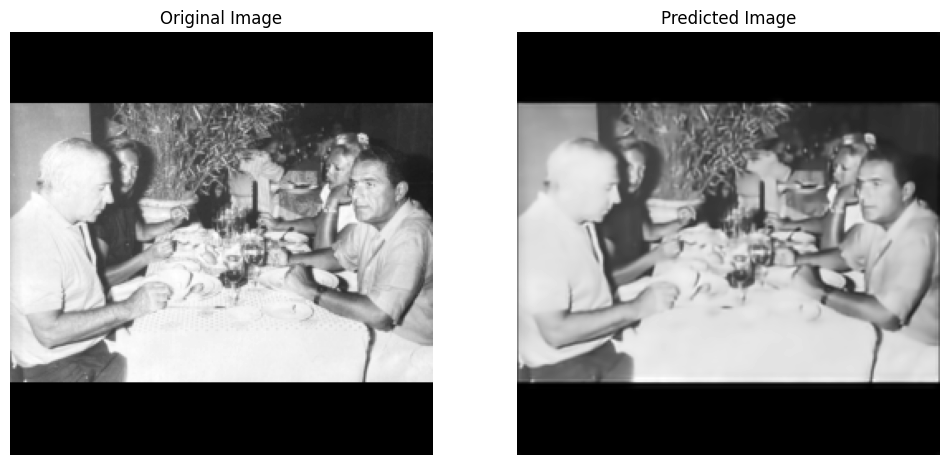

1/1 [==============================] - 0s 179ms/step


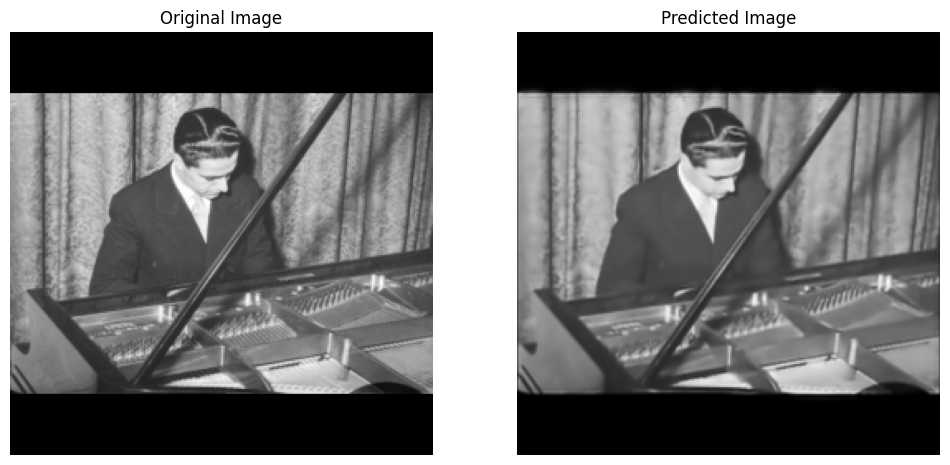

1/1 [==============================] - 0s 176ms/step


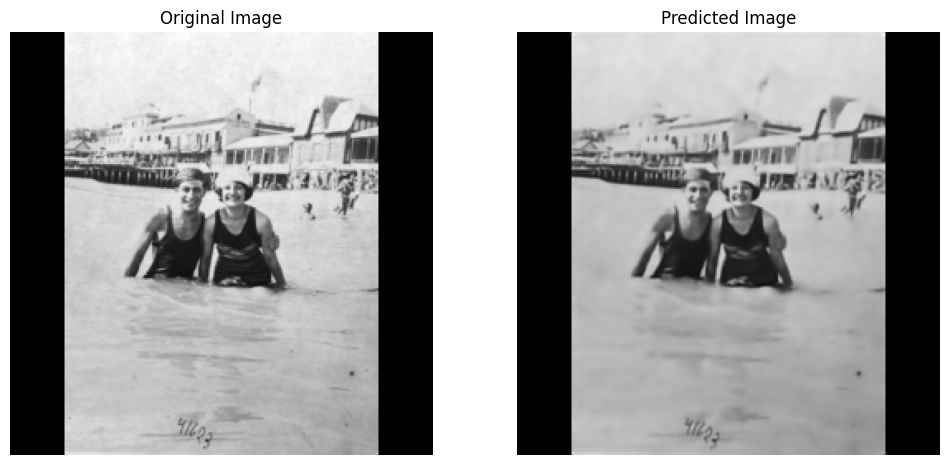

1/1 [==============================] - 0s 177ms/step


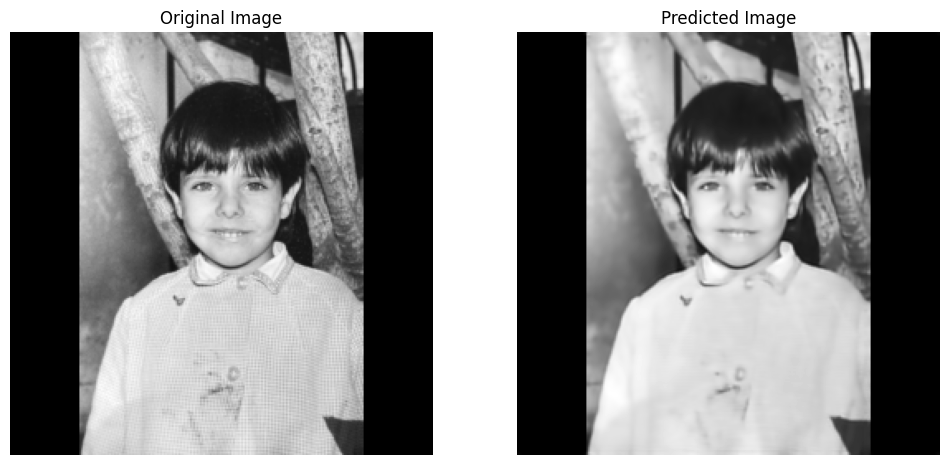

1/1 [==============================] - 0s 176ms/step


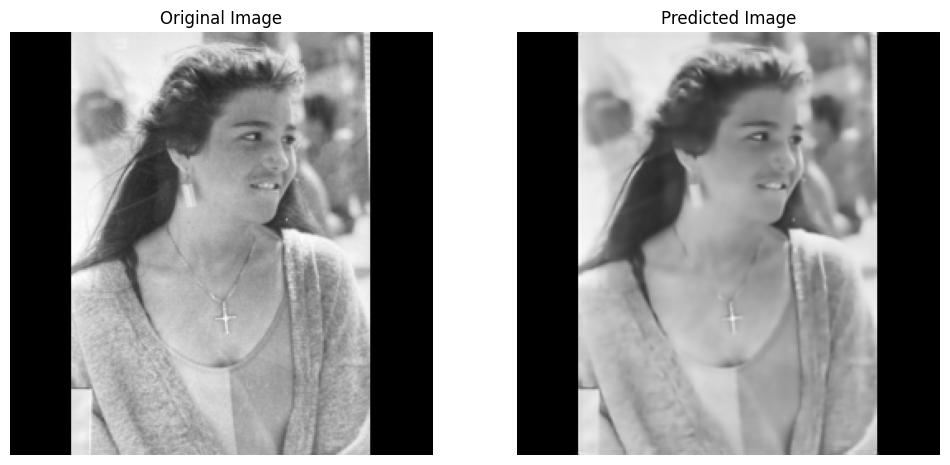

1/1 [==============================] - 0s 177ms/step


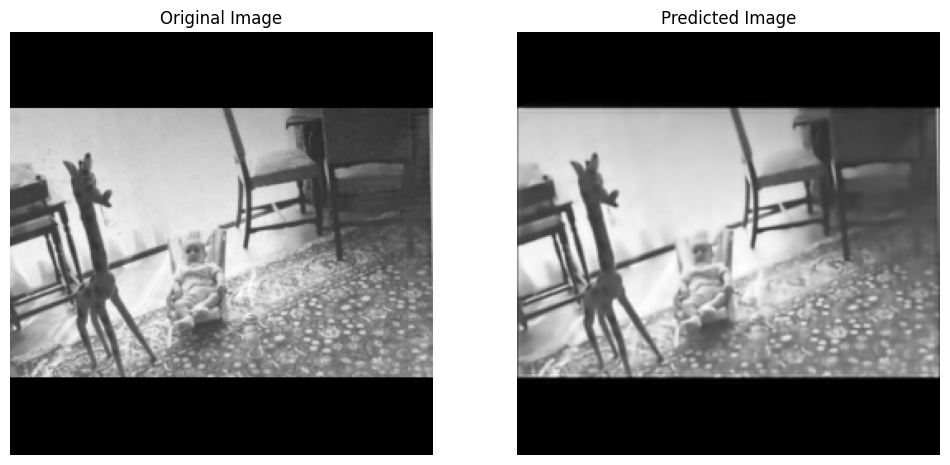

1/1 [==============================] - 0s 176ms/step


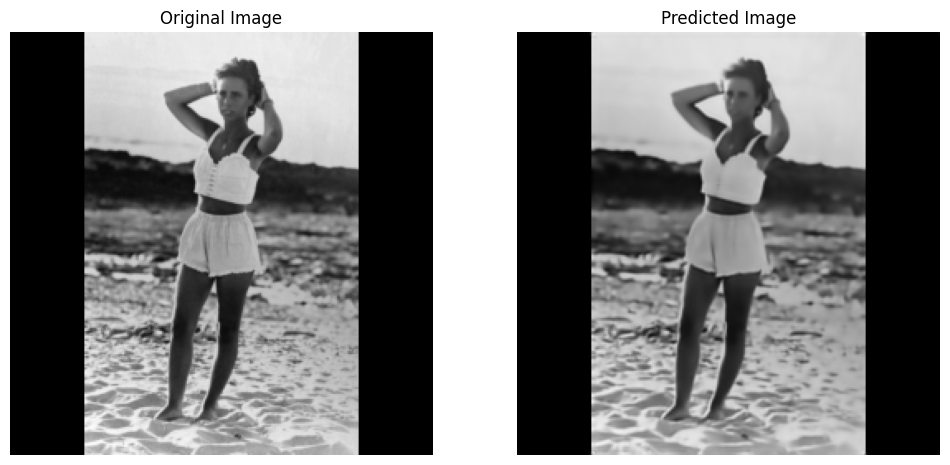

1/1 [==============================] - 0s 176ms/step


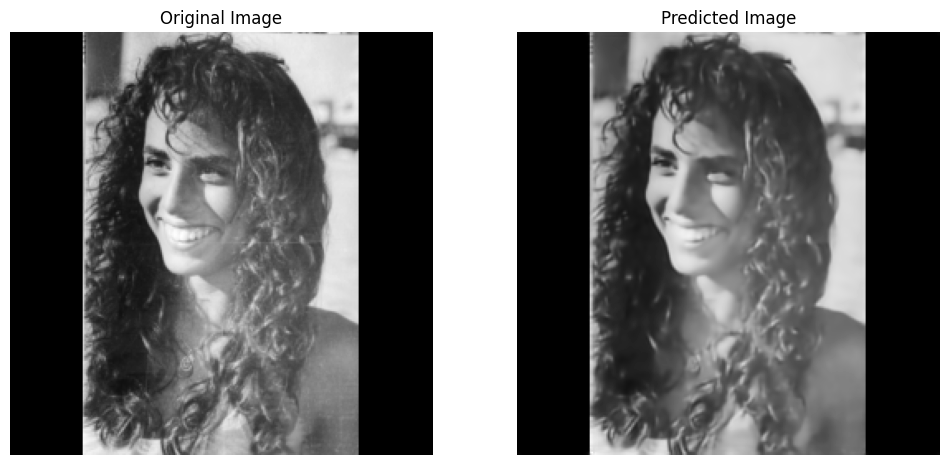

1/1 [==============================] - 0s 187ms/step


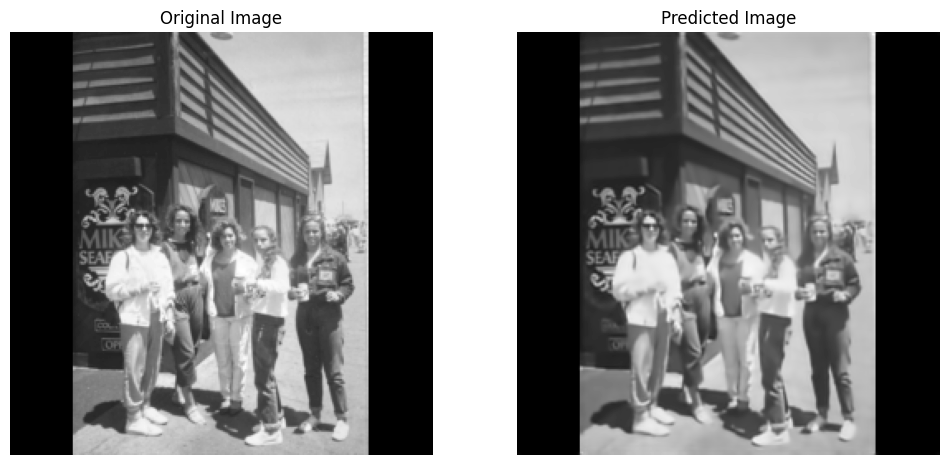

1/1 [==============================] - 0s 183ms/step


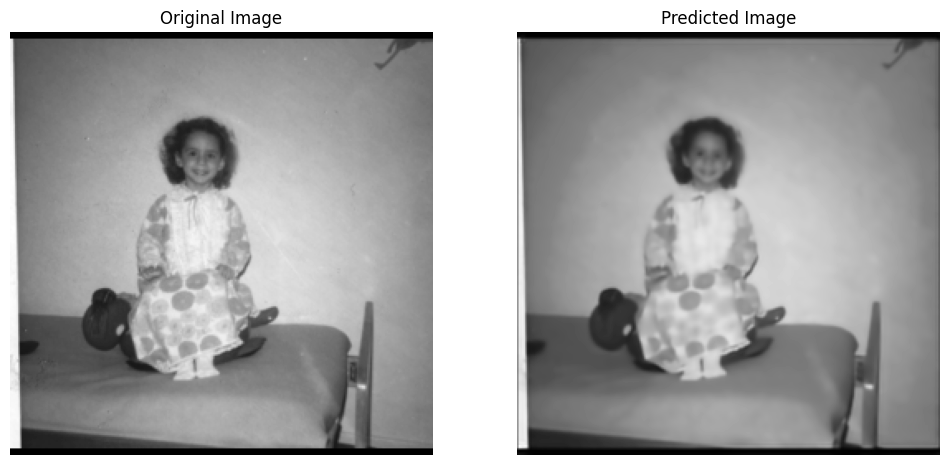

1/1 [==============================] - 0s 186ms/step


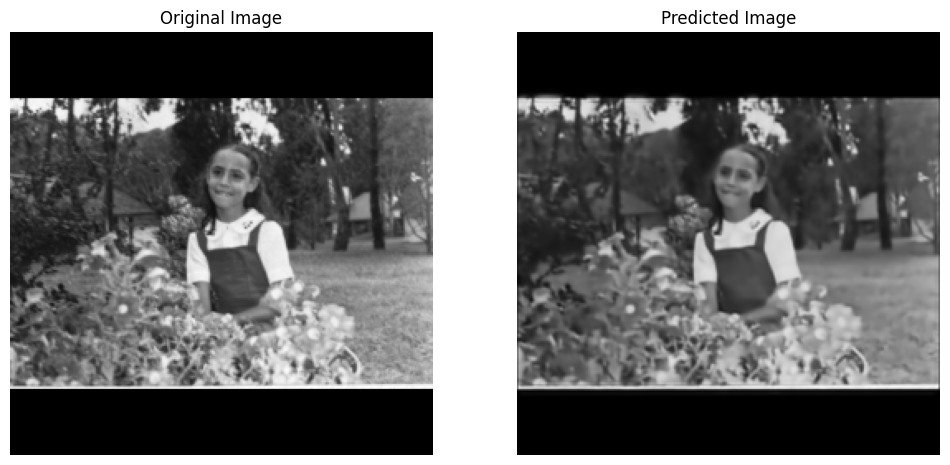

1/1 [==============================] - 0s 181ms/step


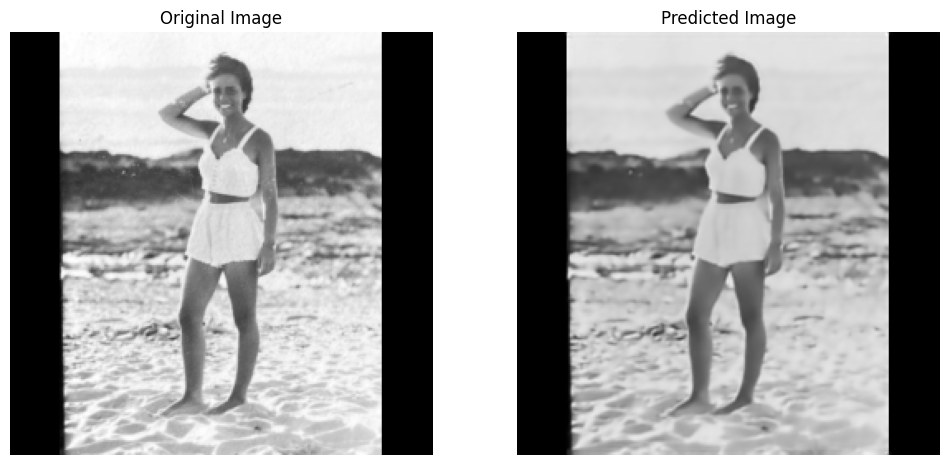

1/1 [==============================] - 0s 181ms/step


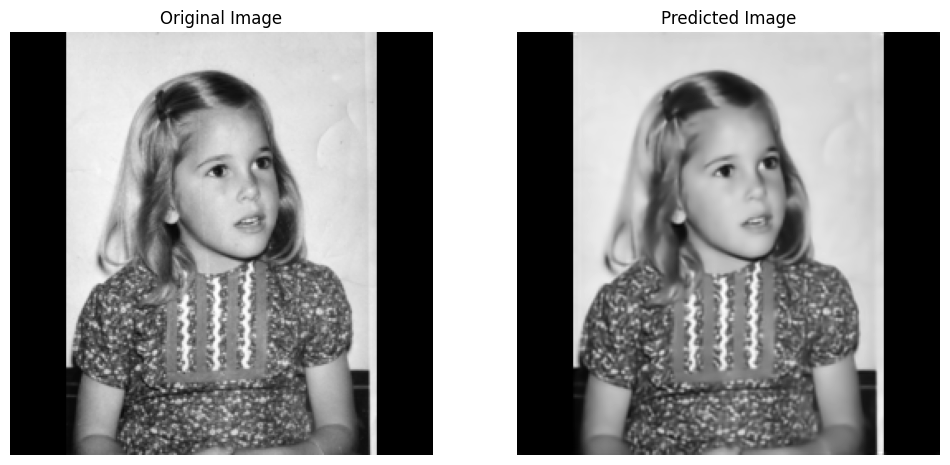

1/1 [==============================] - 0s 178ms/step


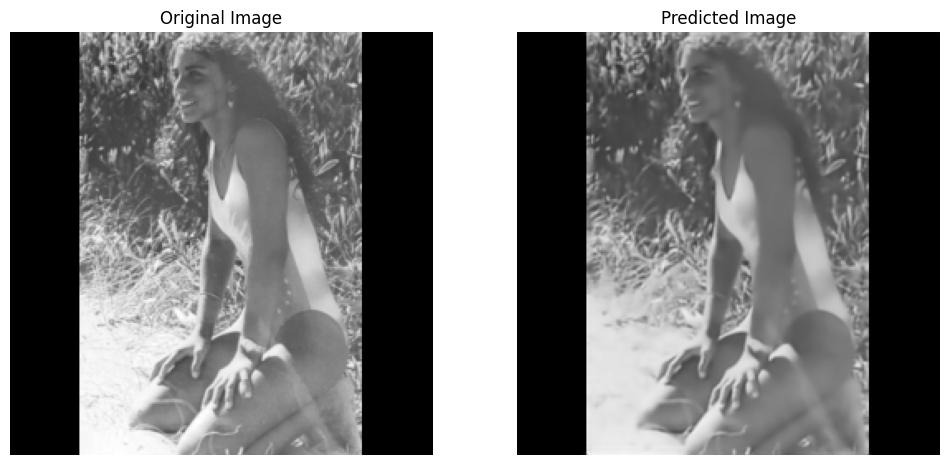

1/1 [==============================] - 0s 178ms/step


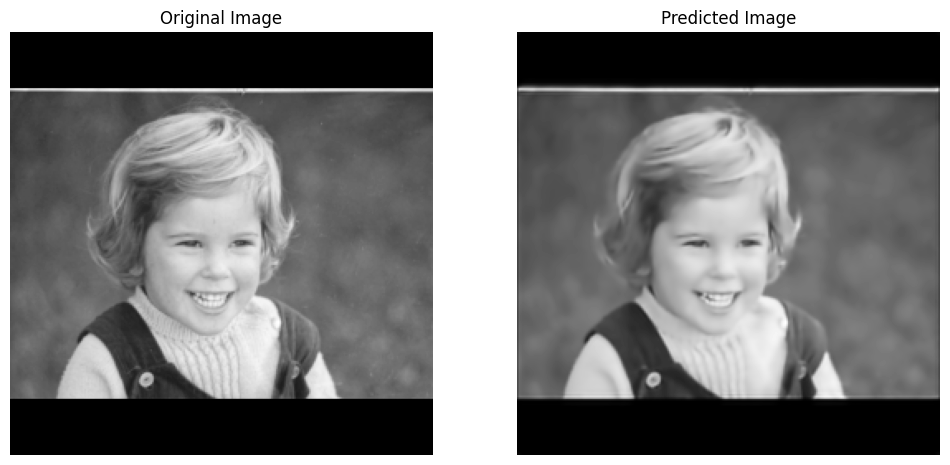

1/1 [==============================] - 0s 182ms/step


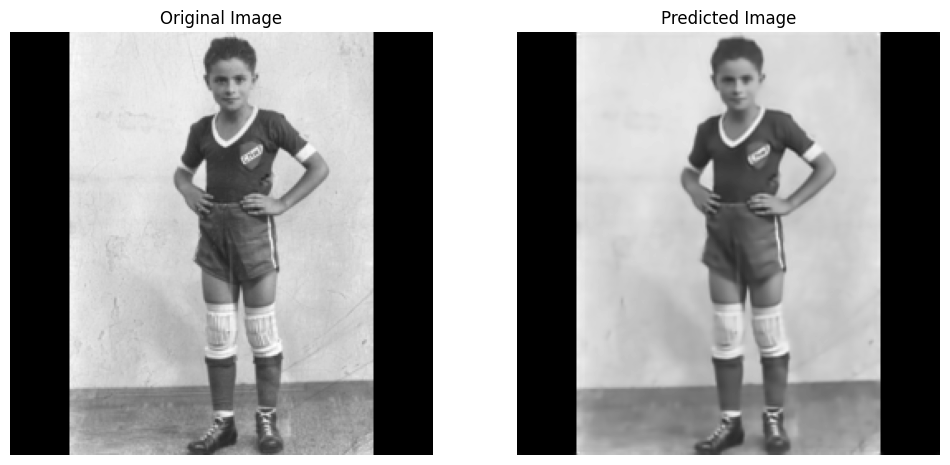

1/1 [==============================] - 0s 177ms/step


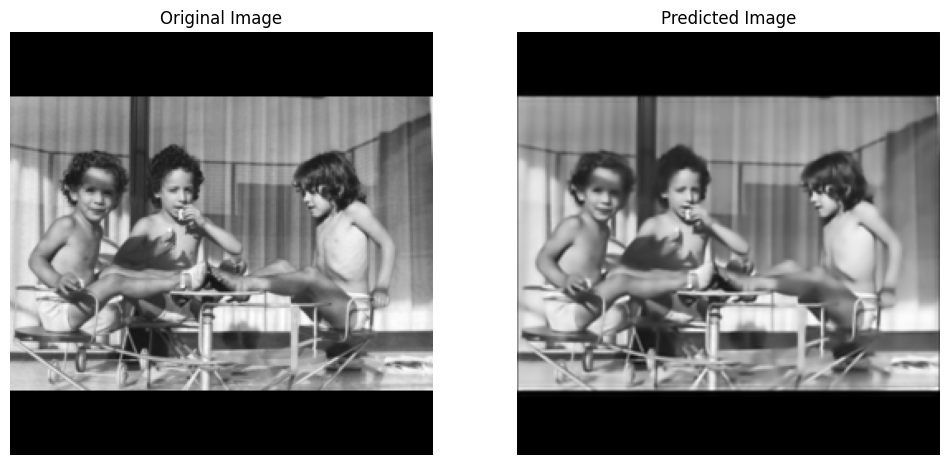

1/1 [==============================] - 0s 175ms/step


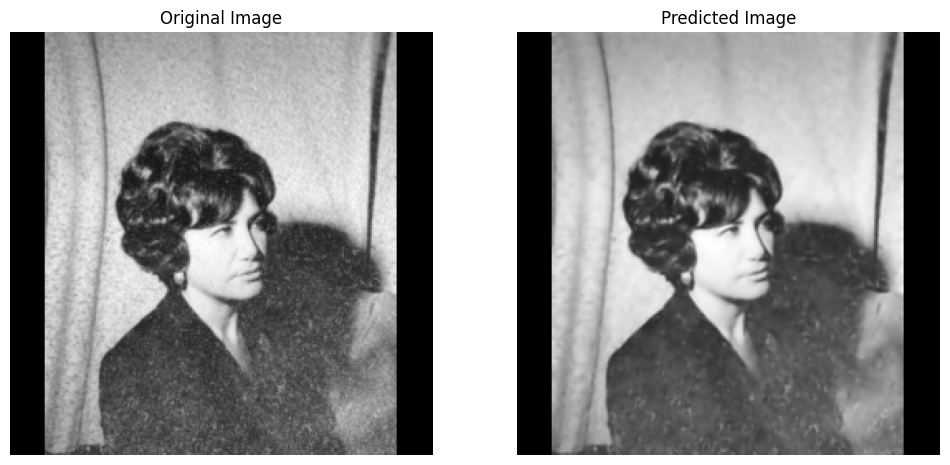

1/1 [==============================] - 0s 177ms/step


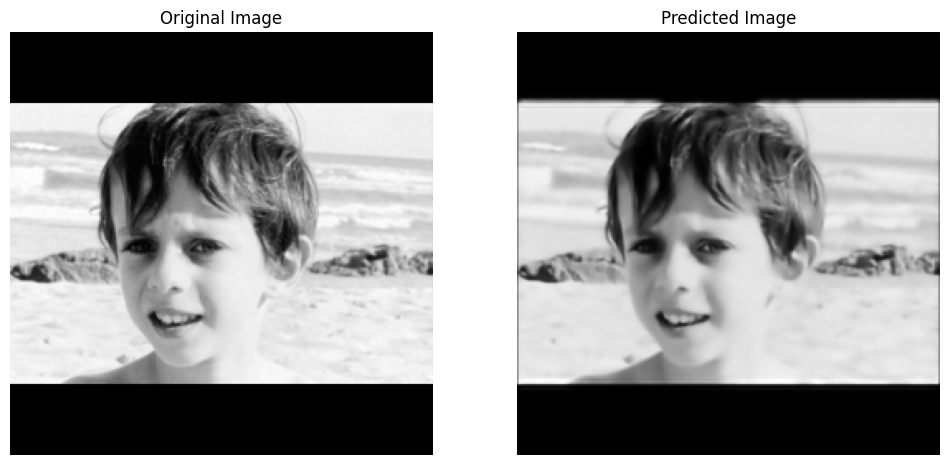

1/1 [==============================] - 0s 176ms/step


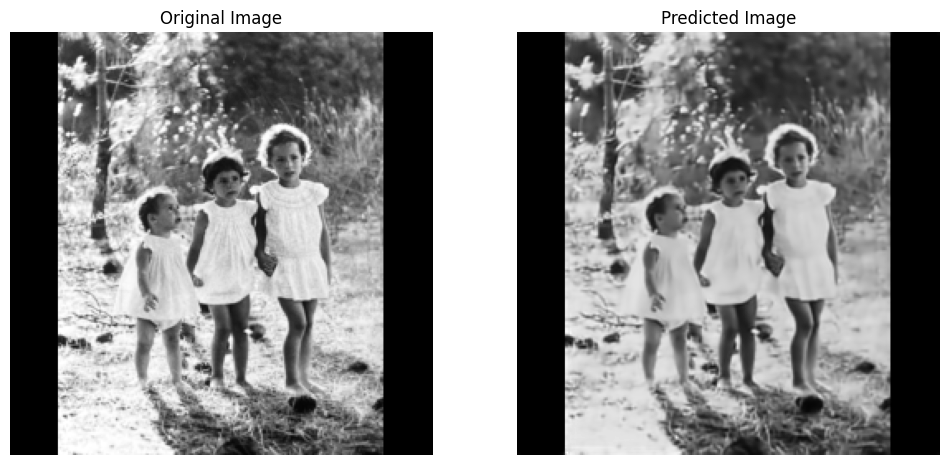

1/1 [==============================] - 0s 175ms/step


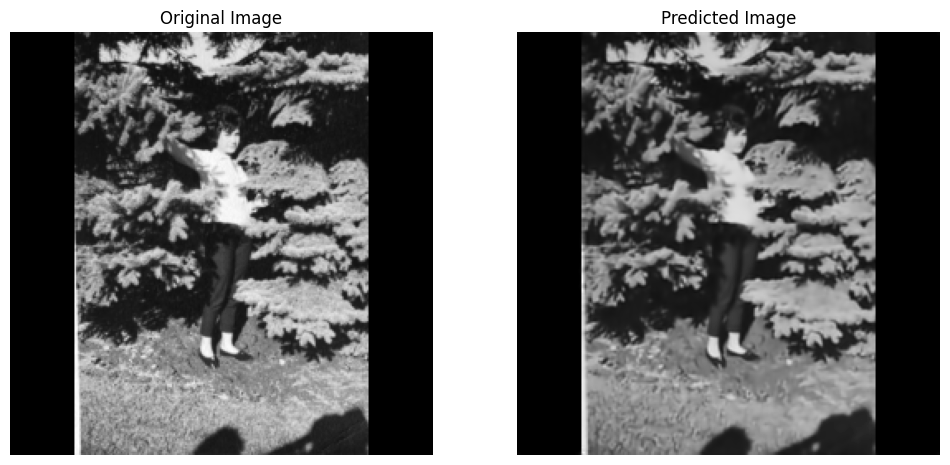

1/1 [==============================] - 0s 175ms/step


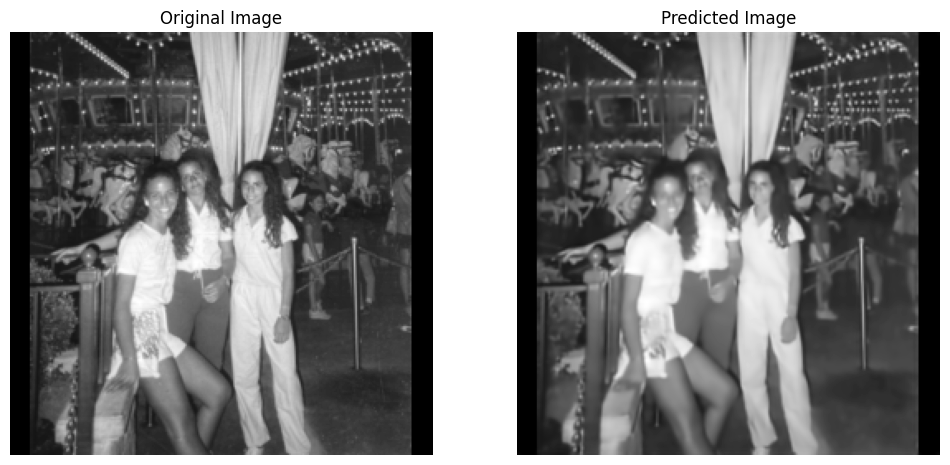

1/1 [==============================] - 1s 557ms/step


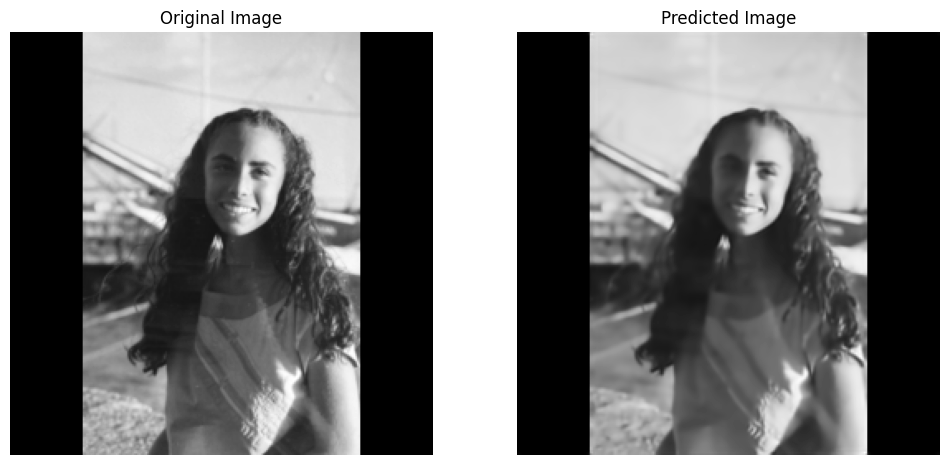

1/1 [==============================] - 0s 183ms/step


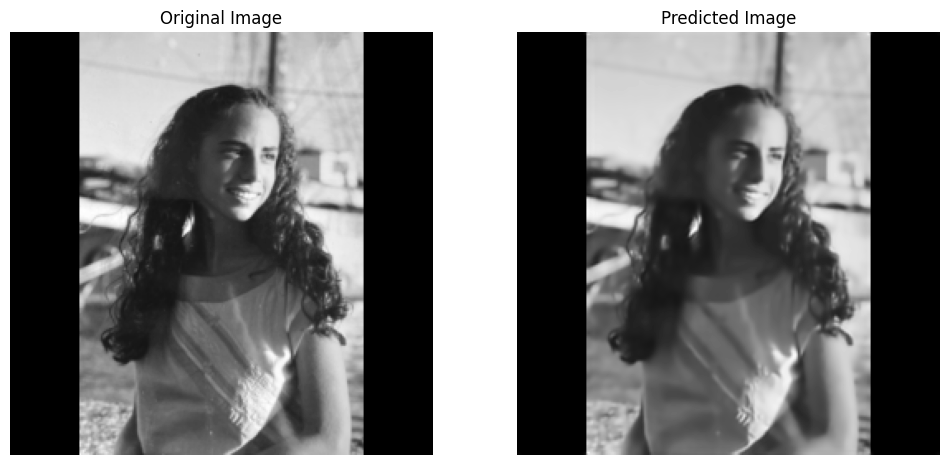

1/1 [==============================] - 0s 186ms/step


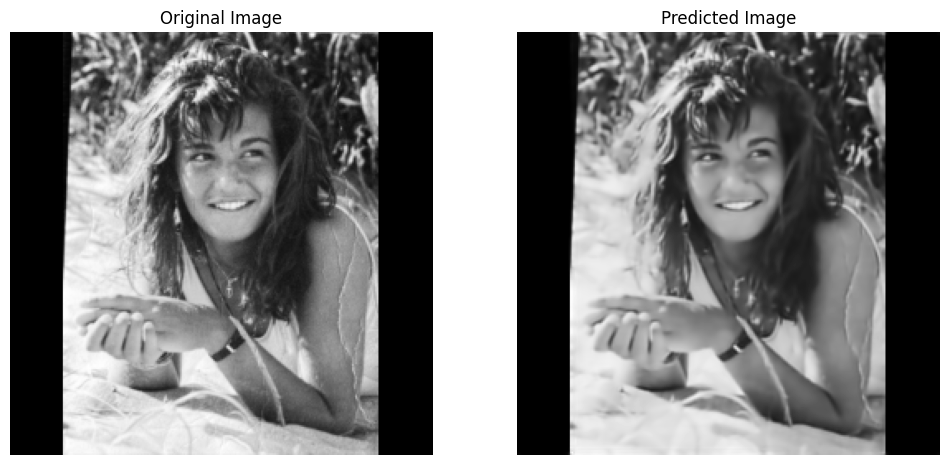

1/1 [==============================] - 0s 177ms/step


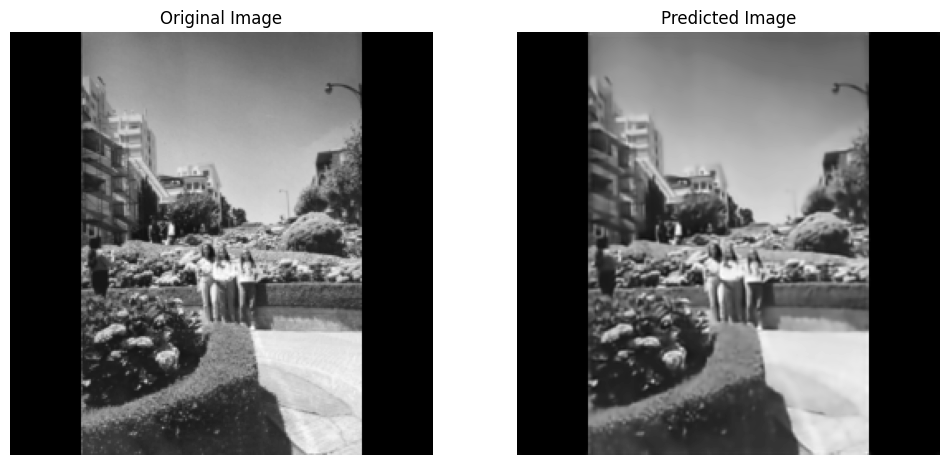

In [ ]:
# Directorios
input_dir = '/content/denoising_model/images'
output_dir = '/content/denoising_model/pre-processed_images'
os.makedirs(output_dir, exist_ok=True)

# Modelo
model_path = '/content/denoising_model/models/dncnn_final_model.h5'

# Procesar cada imagen
for filename in os.listdir(input_dir):
    if filename.lower().endswith('.png'):
        image_path = os.path.join(input_dir, filename)
        predicted_img = plot_predicted_original(model_path, image_path)  # Obtener la imagen predicha

        # Guardar la imagen predicha en la nueva carpeta
        save_path = os.path.join(output_dir, filename)
        save_image(predicted_img.astype(np.uint8), save_path)

1/1 [==============================] - 0s 184ms/step


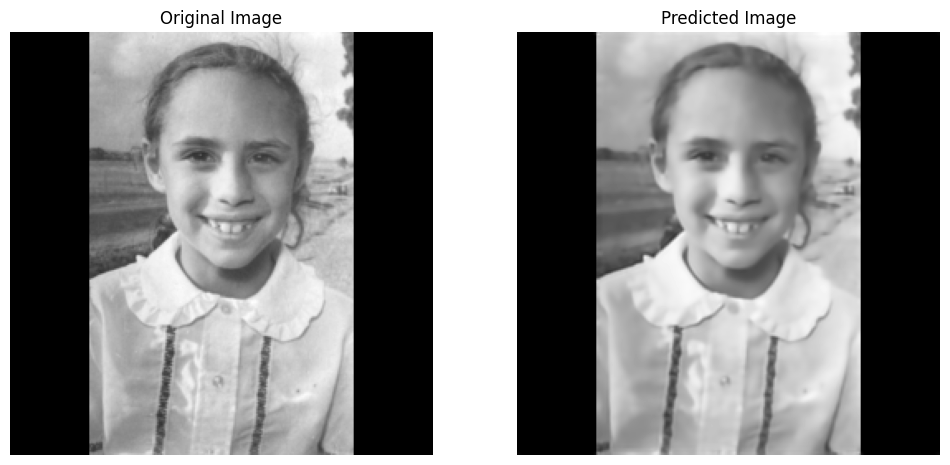

In [ ]:
plot_images_1 = plot_predicted_original('/content/denoising_model/models/dncnn_final_model.h5', '/content/denoising_model/images/IMG_4643.png')

In [ ]:

def test_images(model, test_input, tar, save_filename=False, display_imgs=True):
  path_results = path_output + 'results/'
  if not os.path.exists(path_results):
        os.makedirs(path_results)

  plt.figure(figsize=(10,10))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  if display_imgs:
    for i in range(3):
      plt.subplot(1, 3, i+1)
      plt.title(title[i])
      plt.imshow(np.clip((display_list[i] + 1),0,1))
      plt.axis('off')

      if save_filename:
        plt.savefig(path_results+'test_' + save_filename + '.png')  # Guarda la figura completa como PNG

  plt.show()